In [1]:
# License: BSD
# Author: Sasank Chilamkurthy

from __future__ import print_function, division

import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import numpy as np
import torchvision
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
import time
import os
import copy
from torch.utils.data import Dataset, DataLoader
from PIL import Image
from random import randrange
import torch.nn.functional as F


device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)
plt.ion()   # interactive mode

cuda:0


In [2]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split


dat_race = pd.read_csv('dnd_race.csv')
dat_class = pd.read_csv('dnd_class.csv')

In [3]:
race_sample = dat_race.sample(n=40, random_state=42)
class_sample = dat_class.sample(n=40, random_state=30)


In [4]:
race_sample.head()

,Unnamed: 0,image_number,folder,label
422,114,00000210.jpg,gnome,gnome
75,75,00000099.jpg,dragonborn,dragonborn
177,57,00000071.jpg,elf,elf
30,30,00000035.jpg,dragonborn,dragonborn
361,53,00000072.jpg,gnome,gnome


In [5]:
class_sample.head()

,Unnamed: 0,image_number,folder,label
78,78,00000113.jpg,paladin,paladin
31,31,00000040.jpg,paladin,paladin
148,1,00000001.jpg,rogue,rogue
273,126,00000269.jpg,rogue,rogue
200,53,00000061.jpg,rogue,rogue


In [6]:
model_ft = models.resnet50(pretrained=False)
num_ftrs = model_ft.fc.in_features
model_ft.fc = nn.Linear(num_ftrs, 3)
#for param in model_ft.parameters():
#    param.requires_grad = False

#model_ft.load_state_dict(torch.load('./models/dnd_resnet_50.pth'))

#print(model_ft)
#num_ftrs = model_ft.classifier[6].in_features
num_ftrs = model_ft.fc.in_features
model_ft.fc = nn.Linear(num_ftrs, 512)

race_shape = 3
class_shape = 3

class multi_output_model(torch.nn.Module):
    def __init__(self, model_core):
        super(multi_output_model, self).__init__()
        
        self.resnet_model = model_core
        
        self.x1 =  nn.Linear(512,512)
        nn.init.xavier_normal_(self.x1.weight)
        self.x1a =  nn.Linear(512,512)
        nn.init.xavier_normal_(self.x1a.weight)
        
        self.x2 =  nn.Linear(512,256)
        nn.init.xavier_normal_(self.x2.weight)
        self.x2a =  nn.Linear(256,256)
        nn.init.xavier_normal_(self.x2a.weight)
        
        self.x3 =  nn.Linear(256,128)
        nn.init.xavier_normal_(self.x3.weight)
        self.x3a =  nn.Linear(128,128)
        nn.init.xavier_normal_(self.x3a.weight)
        #comp head 1
        
        
        #heads
        self.y1o = nn.Linear(128,race_shape)
        nn.init.xavier_normal_(self.y1o.weight)#
        self.y2o = nn.Linear(128,class_shape)
        nn.init.xavier_normal_(self.y2o.weight)
        
    def forward(self, x):
       
        x1 = self.resnet_model(x)
        #x1 =  F.relu(self.x1(x1))
        #x1 =  F.relu(self.x2(x1))
        
        x1 =  F.relu(self.x1(x1))
        x1 =  F.relu(self.x1a(x1))
        x1 =  F.relu(self.x2(x1))
        x1 =  F.relu(self.x2a(x1))
        
        x1 =  F.relu(self.x3(x1))
        x1 =  F.relu(self.x3a(x1))
        
        
        #x = F.relu(self.x2(x))
        #x1 = F.relu(self.x3(x))
        
        # heads
        y1o = F.softmax(self.y1o(x1),dim=1)
        y2o = F.softmax(self.y2o(x1),dim=1)
        #y2o = torch.sigmoid(self.y2o(x1)) #should be sigmoid


        return y1o, y2o
model_1 = multi_output_model(model_ft)
model_1 = model_1.to(device)
model_1.load_state_dict(torch.load('./models/masked_resnet34.pth'))
model_1 = model_1.eval()

torch.Size([3, 224, 224])
tensor([[0.0972, 0.4910, 0.4118]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.4215, 0.2937, 0.2847]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


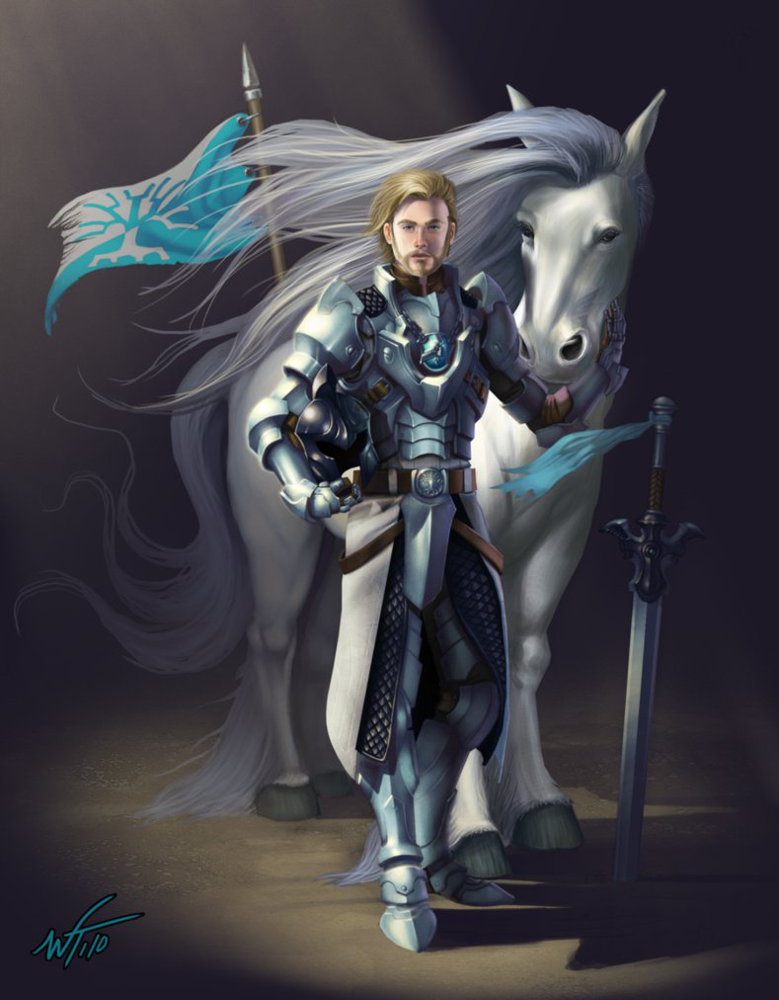

In [7]:

from torch.autograd import Variable

imsize = 224
loader = transforms.Compose([transforms.Resize((imsize,imsize)),
                             transforms.ToTensor(),
                             transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])])

def image_loader(image_name):
    """load image, returns cuda tensor"""
    image = Image.open(image_name)
    image = image.convert('RGB')
    
    image = loader(image).float()
    print(image.shape)
    image = Variable(image, requires_grad=False)
    image = image.unsqueeze(0)  #this is for VGG, may not be needed for ResNet
    return image.cuda()  #assumes that you're using GPU


race_label_list = ['dragonborn', 'human/elf', 'gnome']
class_label_list = ['paladin/warrior', 'rogue', 'wizard']

def extract_label(label_list, pred_array,top_n=1):
    pred_max = torch.topk(pred_array,top_n)[1]
    print(pred_array)
    out_list = []
    for i in pred_max[0]:
        out_list.append(label_list[i])
    return out_list

img_path = 'images/paladin/00000113.jpg'

preds = model_1(image_loader(img_path))

print(extract_label(race_label_list,preds[0]))
print(extract_label(class_label_list,preds[1]))

Image.open(img_path)

torch.Size([3, 224, 224])
images/gnome/00000210.jpg gnome

image:  images/gnome/00000210.jpg
tensor([[0.0028, 0.0131, 0.9841]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['gnome']
tensor([[0.1409, 0.8329, 0.0262]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


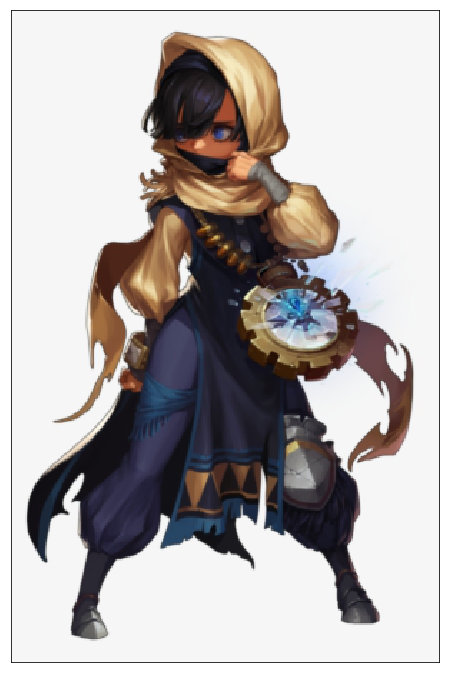

torch.Size([3, 224, 224])
images/dragonborn/00000099.jpg dragonborn

image:  images/dragonborn/00000099.jpg
tensor([[0.6000, 0.3807, 0.0193]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['dragonborn']
tensor([[0.4874, 0.0671, 0.4455]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


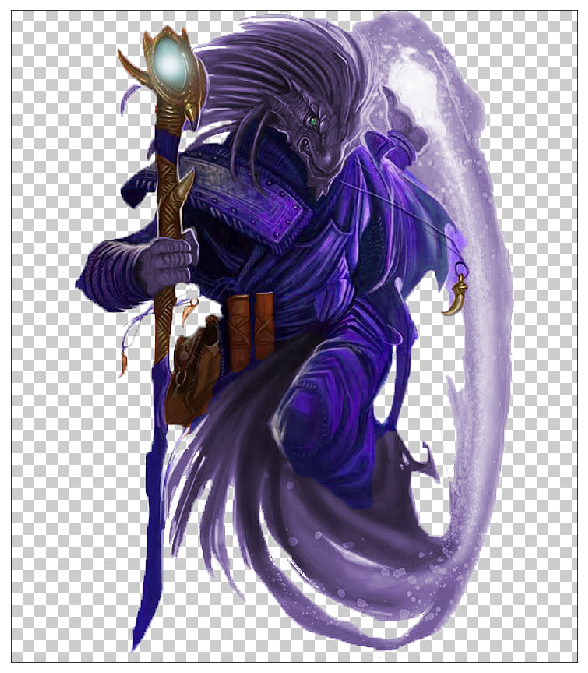

torch.Size([3, 224, 224])
images/elf/00000071.jpg elf

image:  images/elf/00000071.jpg
tensor([[0.0026, 0.6741, 0.3233]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0585, 0.8382, 0.1033]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


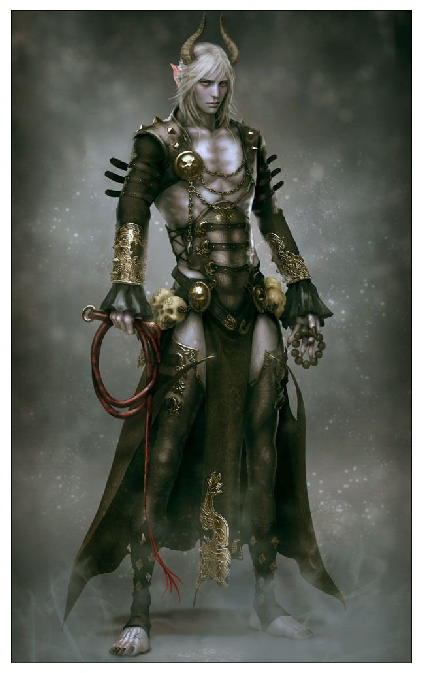

torch.Size([3, 224, 224])
images/dragonborn/00000035.jpg dragonborn

image:  images/dragonborn/00000035.jpg
tensor([[0.9138, 0.0450, 0.0412]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['dragonborn']
tensor([[0.7876, 0.0297, 0.1826]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


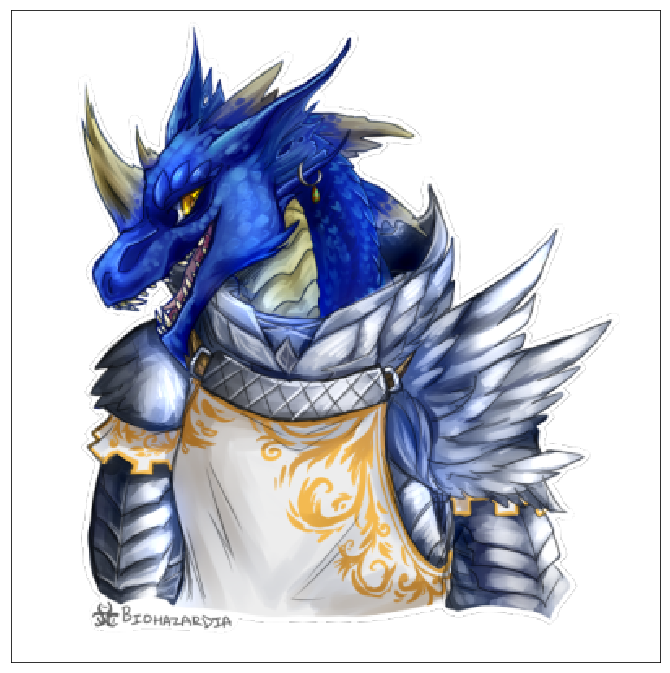

torch.Size([3, 224, 224])
images/gnome/00000072.jpg gnome

image:  images/gnome/00000072.jpg
tensor([[0.0158, 0.0078, 0.9764]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['gnome']
tensor([[0.5986, 0.3702, 0.0312]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


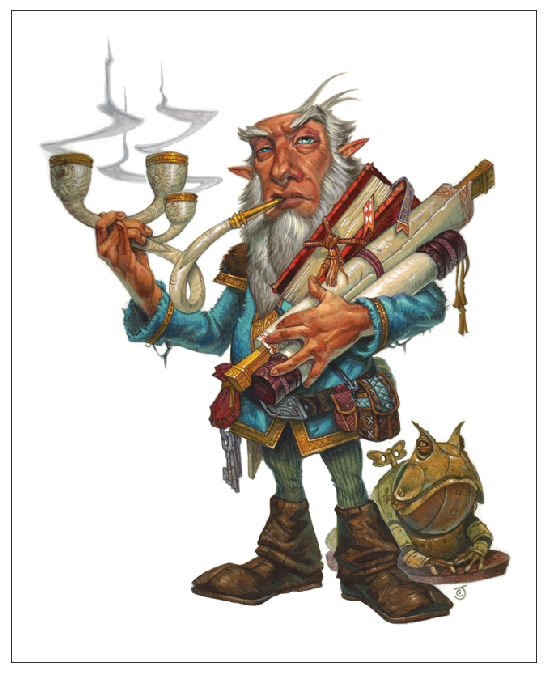

torch.Size([3, 224, 224])
images/gnome/00000101.jpg gnome

image:  images/gnome/00000101.jpg
tensor([[0.0012, 0.9977, 0.0010]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0250, 0.0396, 0.9354]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


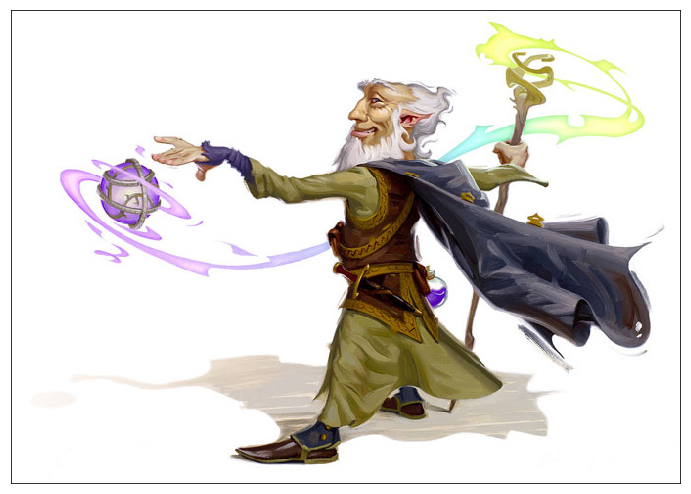

torch.Size([3, 224, 224])
images/elf/00000041.jpg elf

image:  images/elf/00000041.jpg
tensor([[0.0533, 0.8129, 0.1338]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.1650, 0.7725, 0.0625]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


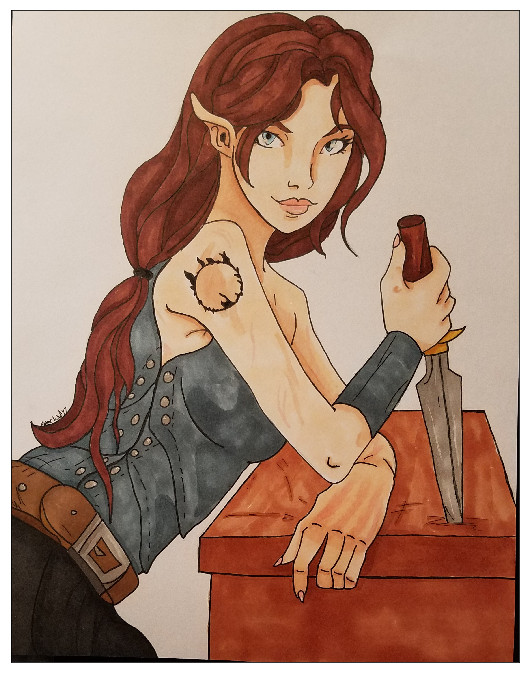

torch.Size([3, 224, 224])
images/elf/00000037.jpg elf

image:  images/elf/00000037.jpg
tensor([[0.0008, 0.0681, 0.9311]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['gnome']
tensor([[0.1305, 0.6678, 0.2016]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


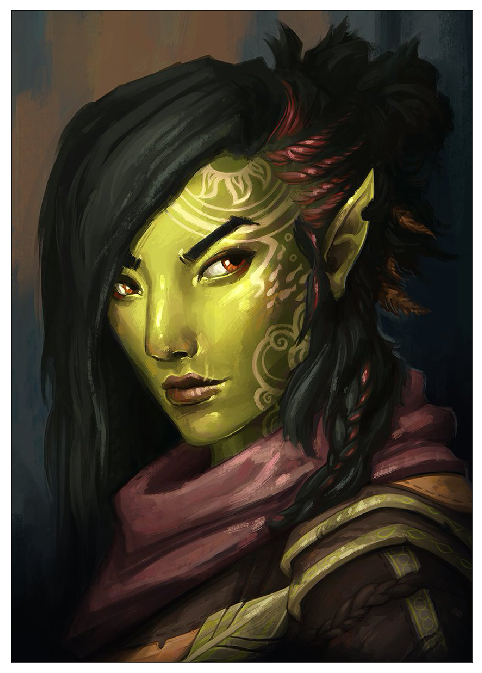

torch.Size([3, 224, 224])
images/elf/00000053.jpg elf

image:  images/elf/00000053.jpg
tensor([[0.0001, 0.9986, 0.0014]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0084, 0.0660, 0.9256]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


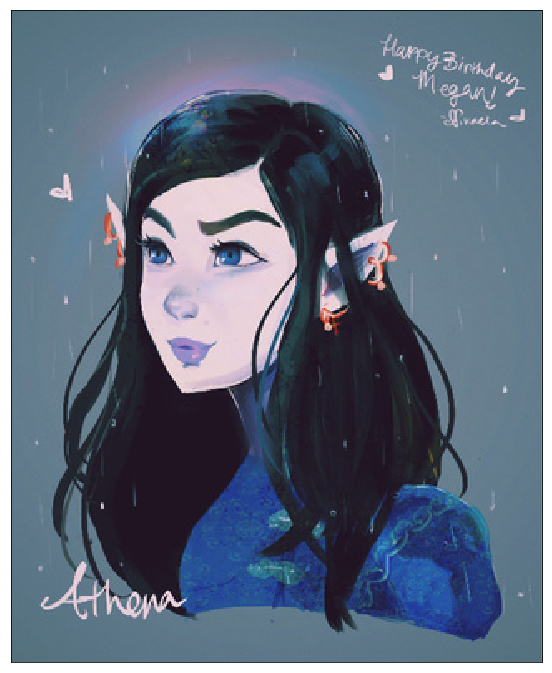

torch.Size([3, 224, 224])
images/elf/00000068.jpg elf

image:  images/elf/00000068.jpg
tensor([[0.0014, 0.9356, 0.0630]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0460, 0.1945, 0.7595]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


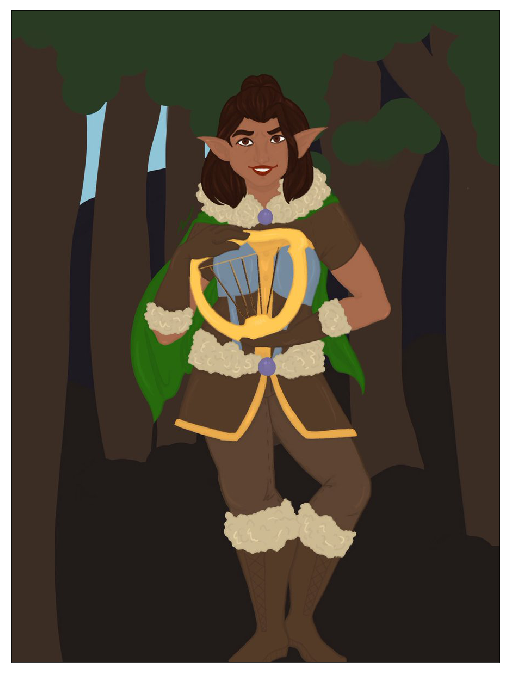

torch.Size([3, 224, 224])
images/gnome/00000169.jpg gnome

image:  images/gnome/00000169.jpg
tensor([[0.0166, 0.4171, 0.5664]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['gnome']
tensor([[0.2137, 0.6985, 0.0879]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


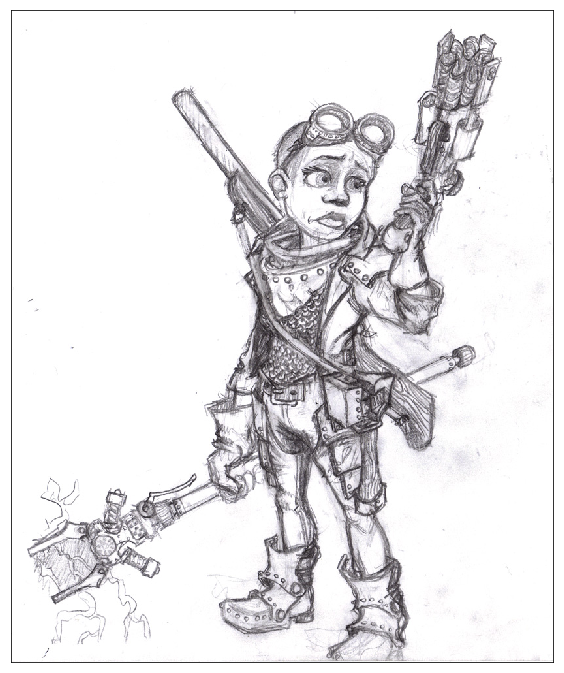

torch.Size([3, 224, 224])
images/dragonborn/00000093.jpg dragonborn

image:  images/dragonborn/00000093.jpg
tensor([[0.9517, 0.0368, 0.0115]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['dragonborn']
tensor([[0.8460, 0.0692, 0.0848]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


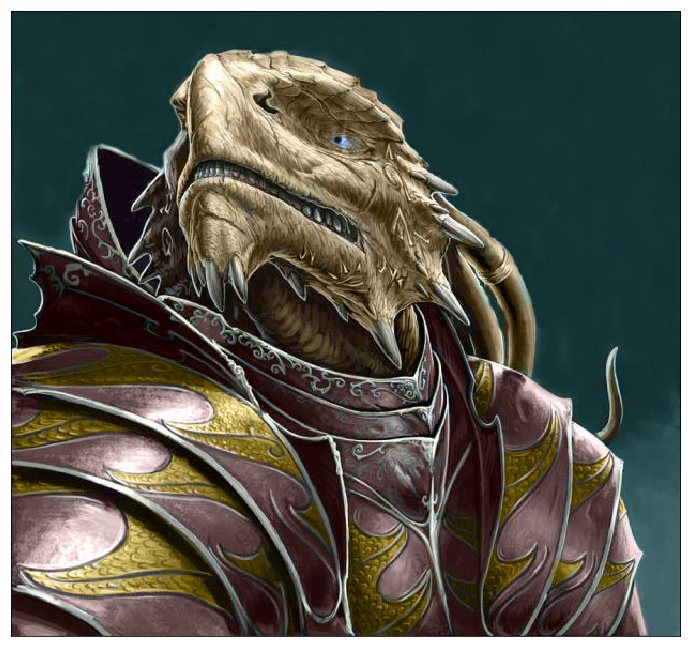

torch.Size([3, 224, 224])
images/elf/00000095.jpg elf

image:  images/elf/00000095.jpg
tensor([[0.0011, 0.9567, 0.0422]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0363, 0.3212, 0.6425]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


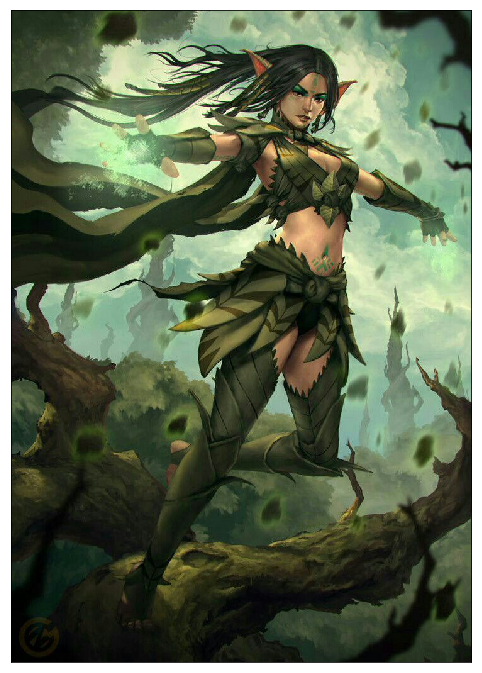

torch.Size([3, 224, 224])
images/gnome/00000029.jpg gnome

image:  images/gnome/00000029.jpg
tensor([[0.0062, 0.0948, 0.8989]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['gnome']
tensor([[0.0972, 0.8341, 0.0686]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


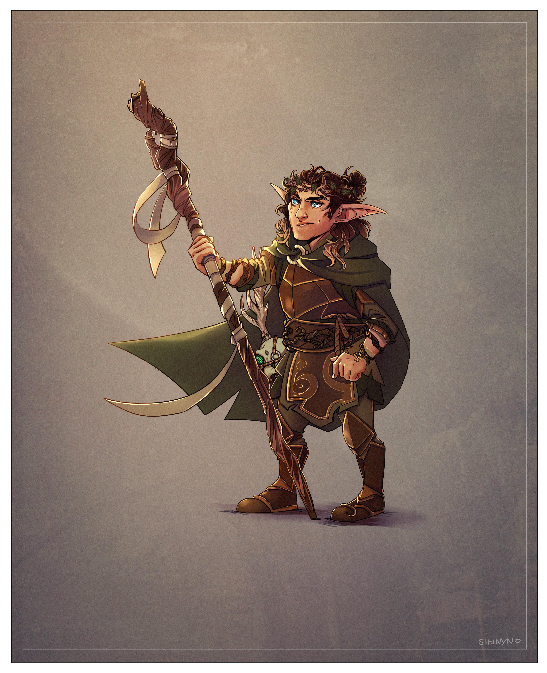

torch.Size([3, 224, 224])
images/dragonborn/00000046.jpg dragonborn

image:  images/dragonborn/00000046.jpg
tensor([[0.9963, 0.0009, 0.0028]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['dragonborn']
tensor([[0.9589, 0.0378, 0.0032]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


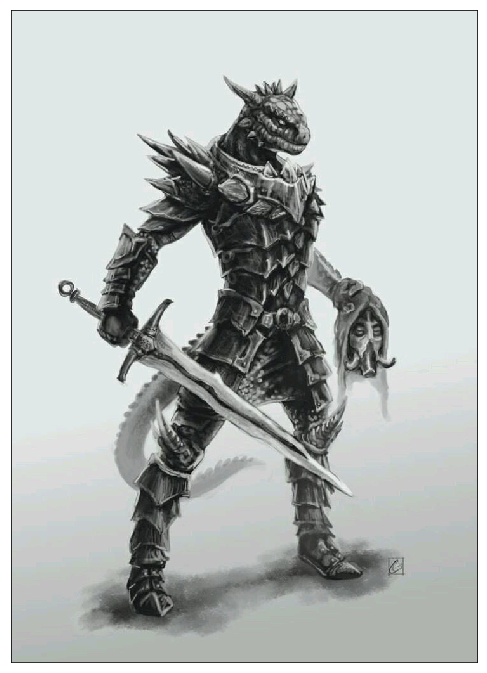

torch.Size([3, 224, 224])
images/elf/00000025.jpg elf

image:  images/elf/00000025.jpg
tensor([[0.0010, 0.8686, 0.1304]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0377, 0.8615, 0.1008]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


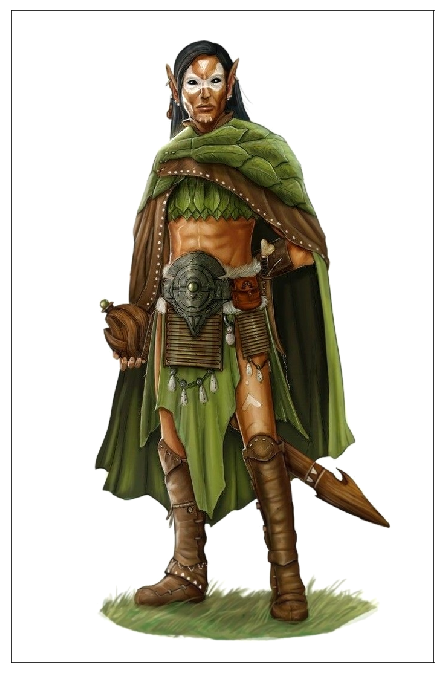

torch.Size([3, 224, 224])
images/elf/00000207.jpg elf

image:  images/elf/00000207.jpg
tensor([[0.4810, 0.3631, 0.1560]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['dragonborn']
tensor([[0.5582, 0.0813, 0.3605]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


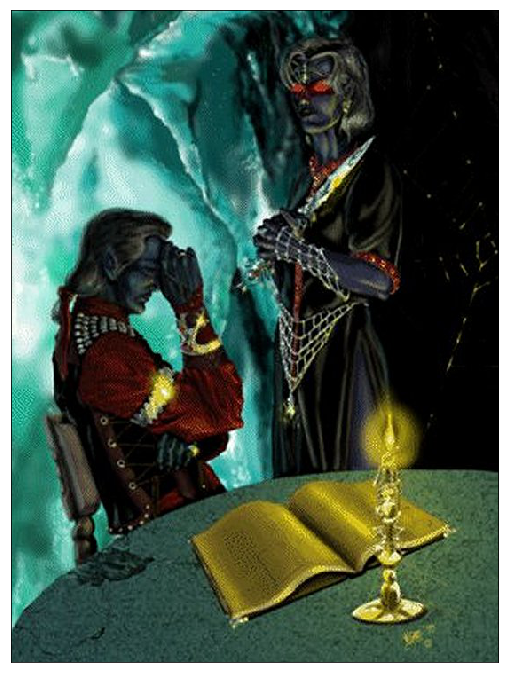

torch.Size([3, 224, 224])
images/dragonborn/00000095.jpg dragonborn

image:  images/dragonborn/00000095.jpg
tensor([[0.9938, 0.0024, 0.0039]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['dragonborn']
tensor([[0.9081, 0.0855, 0.0064]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


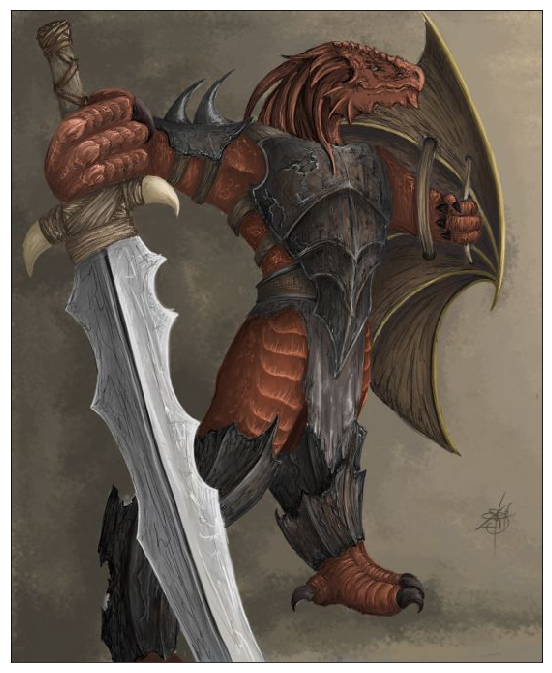

torch.Size([3, 224, 224])
images/dragonborn/00000012.jpg dragonborn

image:  images/dragonborn/00000012.jpg
tensor([[0.9907, 0.0031, 0.0061]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['dragonborn']
tensor([[0.9090, 0.0830, 0.0080]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


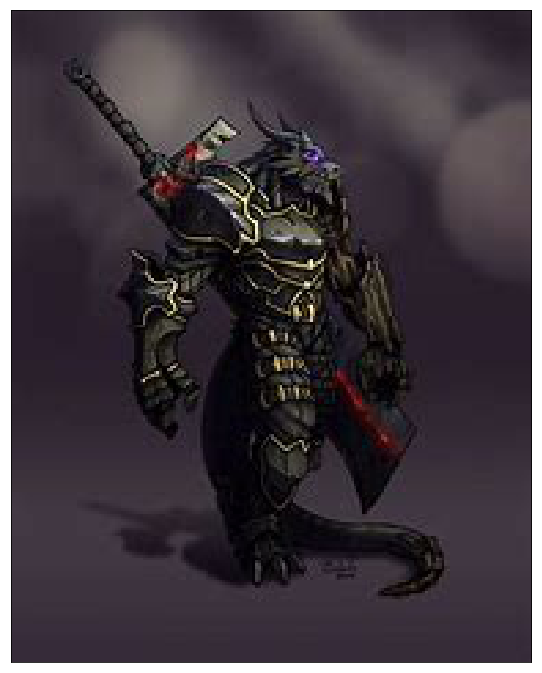

torch.Size([3, 224, 224])
images/elf/00000216.jpg elf

image:  images/elf/00000216.jpg
tensor([[0.0079, 0.9680, 0.0240]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.2354, 0.5003, 0.2643]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


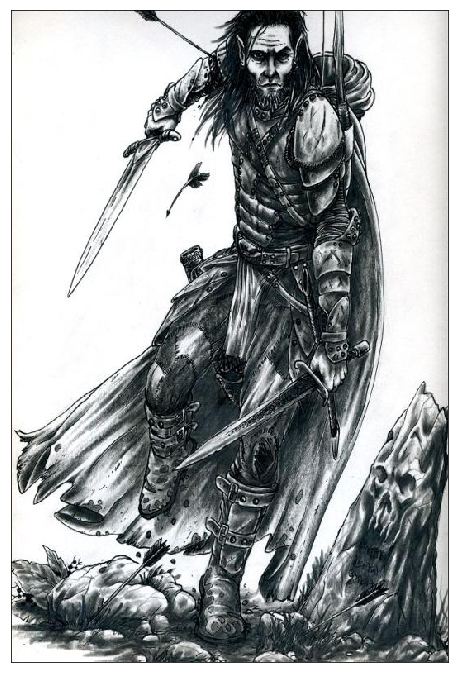

torch.Size([3, 224, 224])
images/elf/00000228.jpg elf

image:  images/elf/00000228.jpg
tensor([[0.0036, 0.9845, 0.0119]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.1062, 0.5198, 0.3741]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


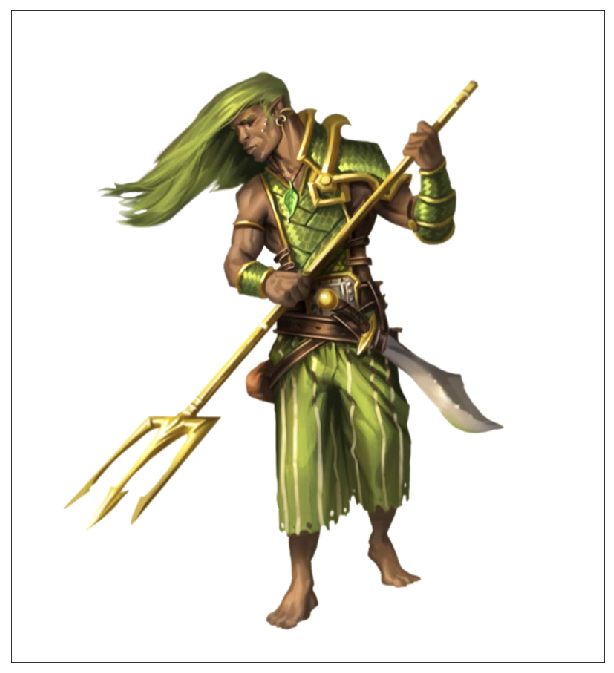

torch.Size([3, 224, 224])
images/elf/00000242.jpg elf

image:  images/elf/00000242.jpg
tensor([[0.9925, 0.0029, 0.0046]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['dragonborn']
tensor([[0.9463, 0.0422, 0.0116]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


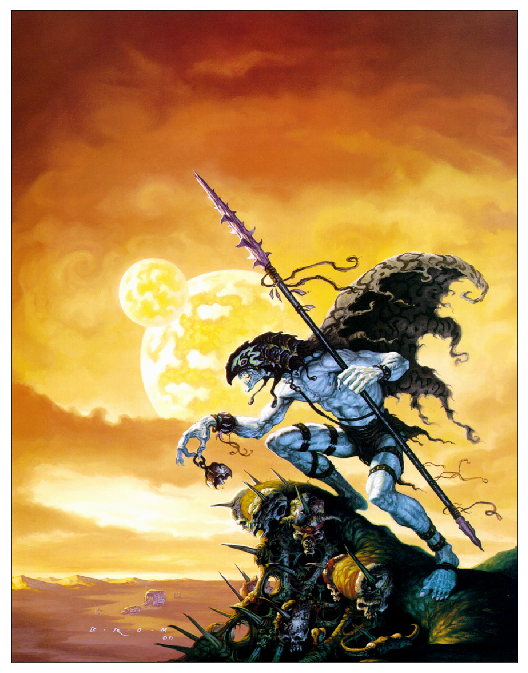

torch.Size([3, 224, 224])
images/gnome/00000122.jpg gnome

image:  images/gnome/00000122.jpg
tensor([[0.0009, 0.0069, 0.9921]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['gnome']
tensor([[0.2354, 0.6893, 0.0753]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


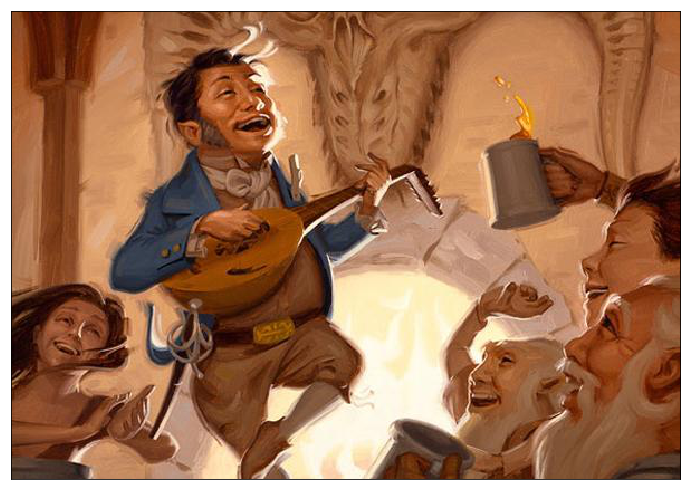

torch.Size([3, 224, 224])
images/dragonborn/00000066.jpg dragonborn

image:  images/dragonborn/00000066.jpg
tensor([[0.9264, 0.0029, 0.0707]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['dragonborn']
tensor([[0.9176, 0.0752, 0.0072]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


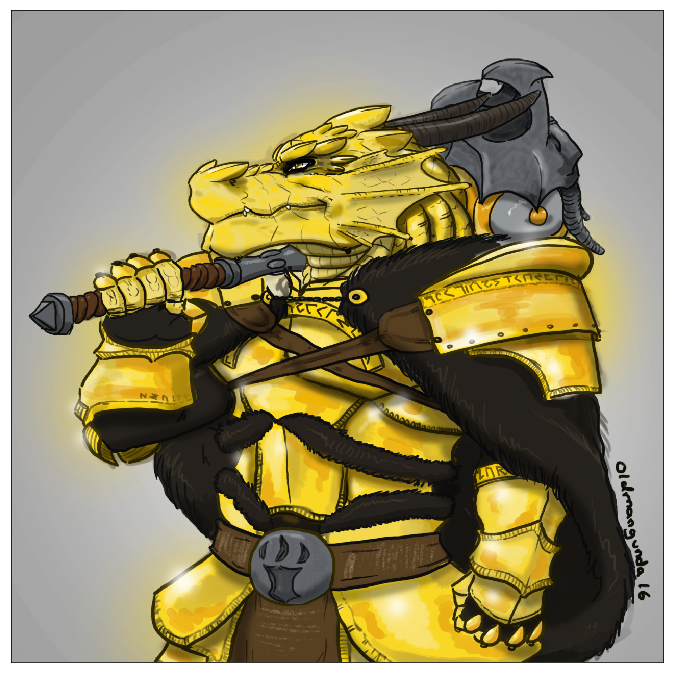

torch.Size([3, 224, 224])
images/elf/00000024.jpg elf

image:  images/elf/00000024.jpg
tensor([[0.0001, 0.9995, 0.0004]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0085, 0.0473, 0.9442]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


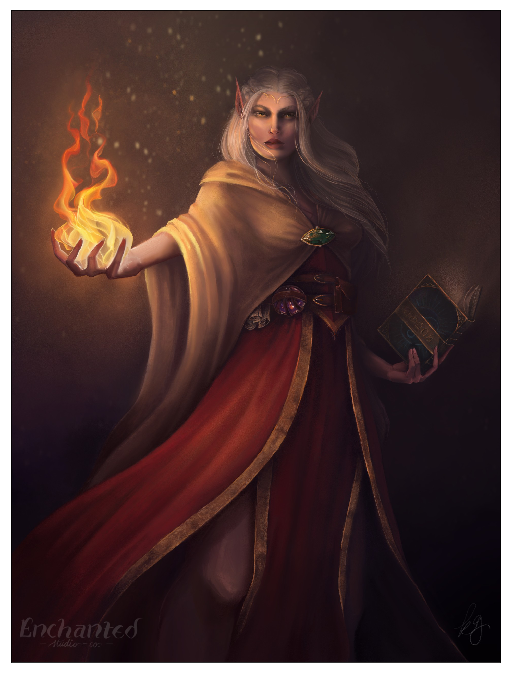

torch.Size([3, 224, 224])
images/elf/00000093.jpg elf

image:  images/elf/00000093.jpg
tensor([[0.0197, 0.9671, 0.0132]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.1601, 0.6945, 0.1454]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


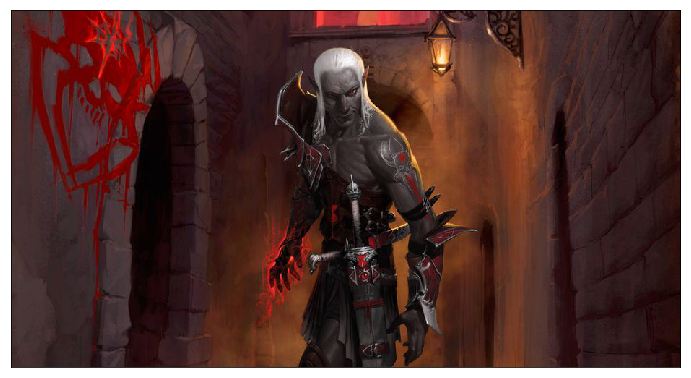

torch.Size([3, 224, 224])
images/elf/00000029.jpg elf

image:  images/elf/00000029.jpg
tensor([[0.9784, 0.0119, 0.0097]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['dragonborn']
tensor([[0.8775, 0.0954, 0.0270]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


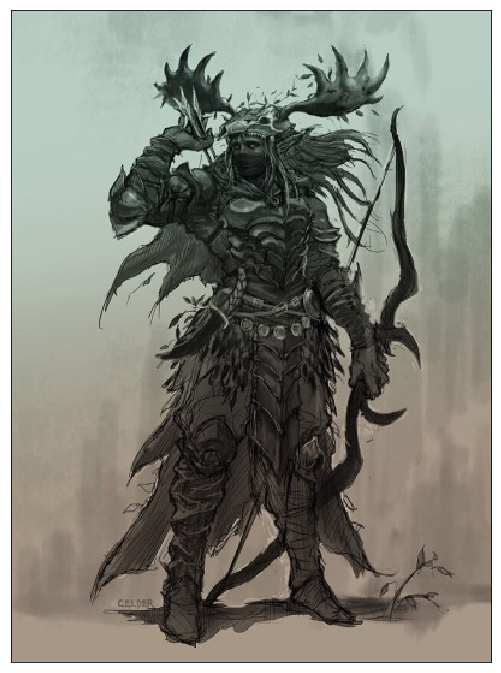

torch.Size([3, 224, 224])
images/gnome/00000123.jpg gnome

image:  images/gnome/00000123.jpg
tensor([[0.0013, 0.0101, 0.9886]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['gnome']
tensor([[0.1273, 0.8556, 0.0172]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


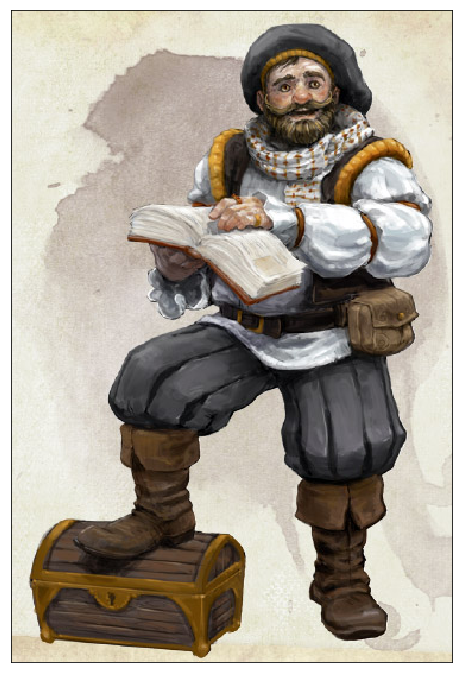

torch.Size([3, 224, 224])
images/elf/00000163.jpg elf

image:  images/elf/00000163.jpg
tensor([[0.0002, 0.9184, 0.0814]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0239, 0.5364, 0.4397]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


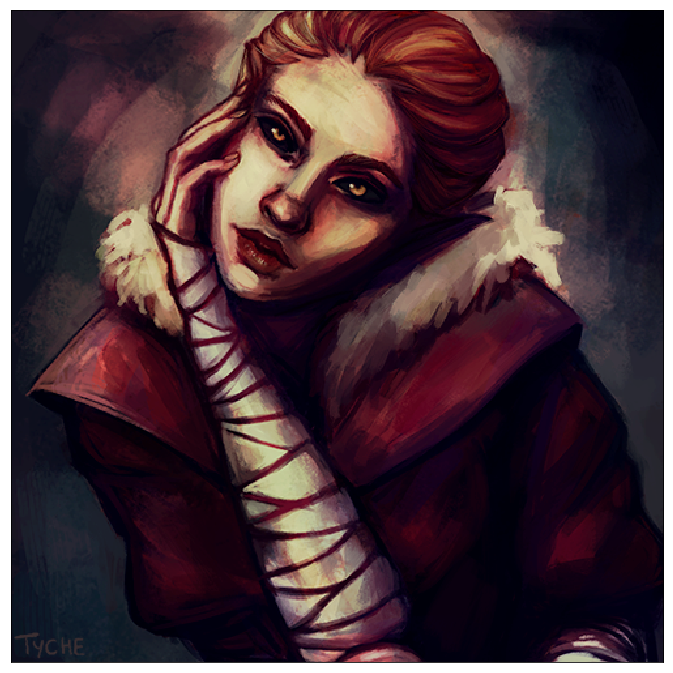

torch.Size([3, 224, 224])
images/elf/00000201.jpg elf

image:  images/elf/00000201.jpg
tensor([[0.0164, 0.9553, 0.0283]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.1769, 0.1646, 0.6585]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


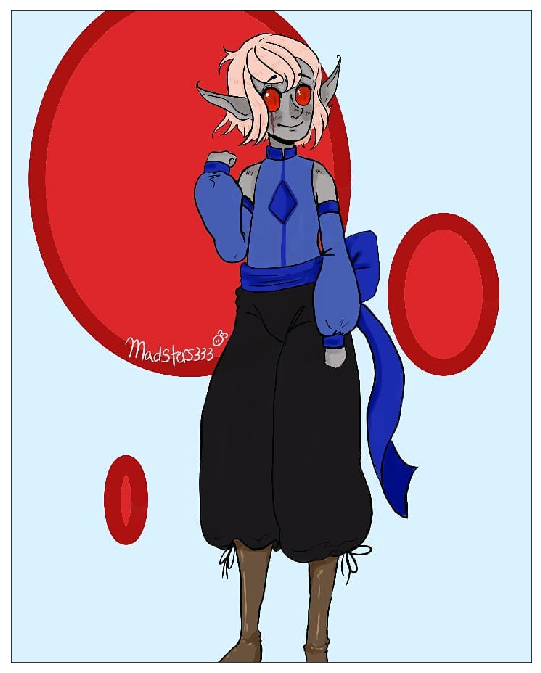

torch.Size([3, 224, 224])
images/elf/00000009.jpg elf

image:  images/elf/00000009.jpg
tensor([[0.0005, 0.9993, 0.0002]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0405, 0.2637, 0.6957]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


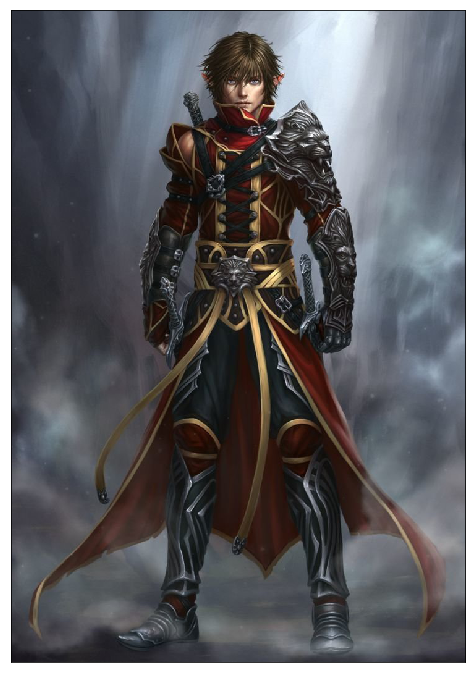

torch.Size([3, 224, 224])
images/elf/00000178.jpg elf

image:  images/elf/00000178.jpg
tensor([[0.0042, 0.9938, 0.0020]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.1658, 0.4541, 0.3801]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


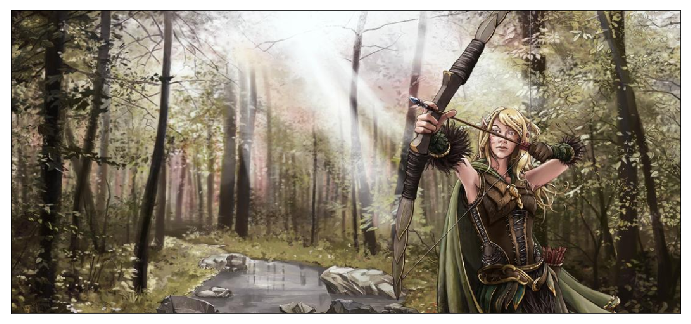

torch.Size([3, 224, 224])
images/elf/00000282.jpg elf

image:  images/elf/00000282.jpg
tensor([[0.0001, 0.9980, 0.0019]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0129, 0.1537, 0.8335]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


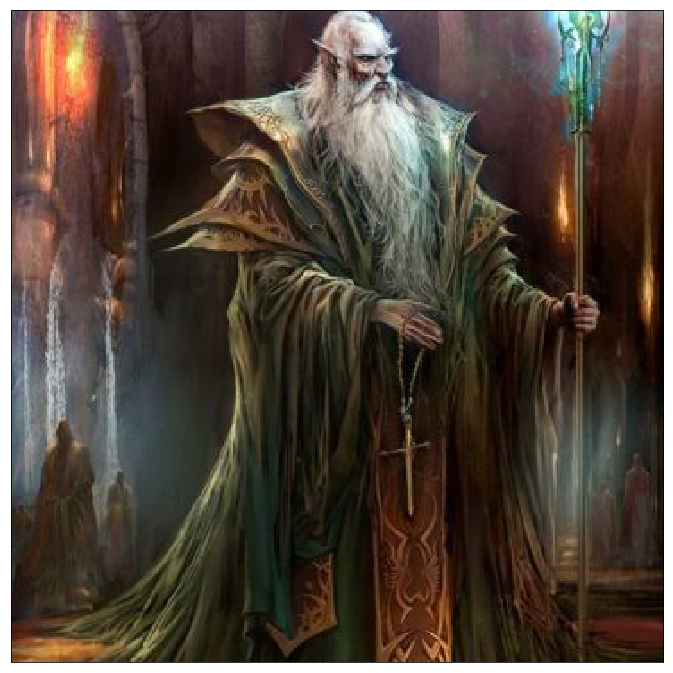

torch.Size([3, 224, 224])
images/dragonborn/00000125.jpg dragonborn

image:  images/dragonborn/00000125.jpg
tensor([[0.0114, 0.6332, 0.3554]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.1697, 0.5305, 0.2998]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


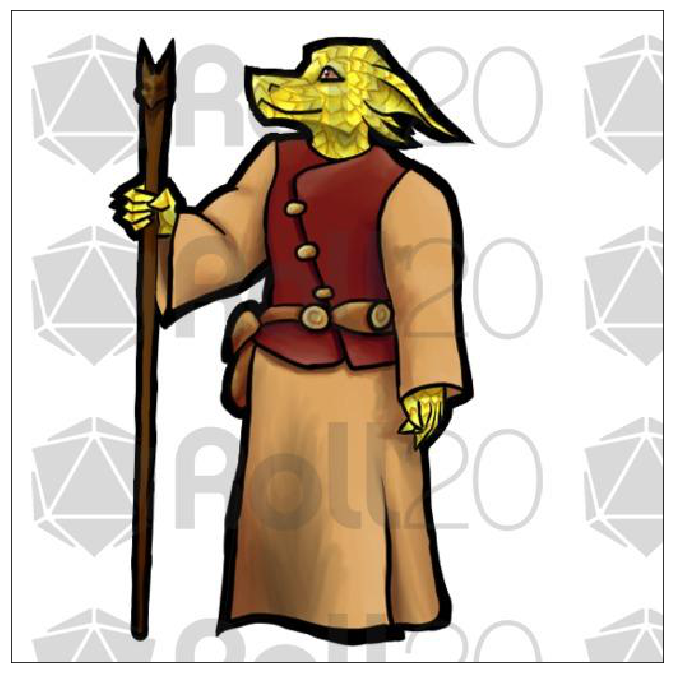

torch.Size([3, 224, 224])
images/gnome/00000223.jpg gnome

image:  images/gnome/00000223.jpg
tensor([[0.0014, 0.0030, 0.9956]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['gnome']
tensor([[0.1728, 0.8121, 0.0151]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


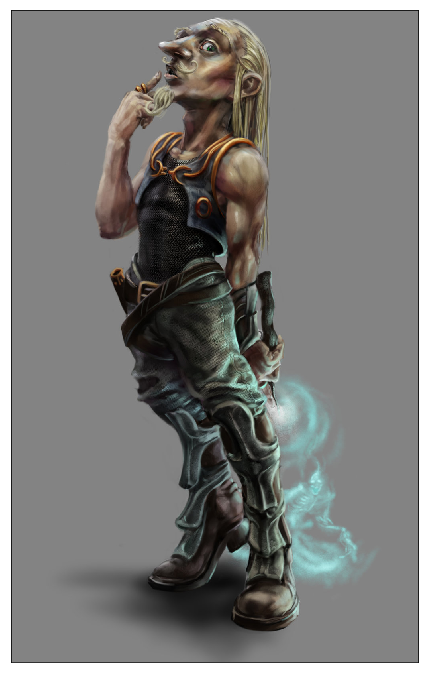

torch.Size([3, 224, 224])
images/dragonborn/00000101.jpg dragonborn

image:  images/dragonborn/00000101.jpg
tensor([[0.9301, 0.0405, 0.0294]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['dragonborn']
tensor([[0.7876, 0.0591, 0.1534]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


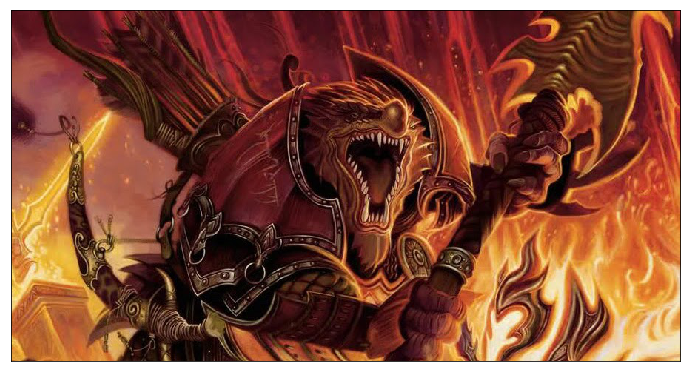

torch.Size([3, 224, 224])
images/elf/00000109.jpg elf

image:  images/elf/00000109.jpg
tensor([[0.0015, 0.9953, 0.0032]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0297, 0.0402, 0.9302]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


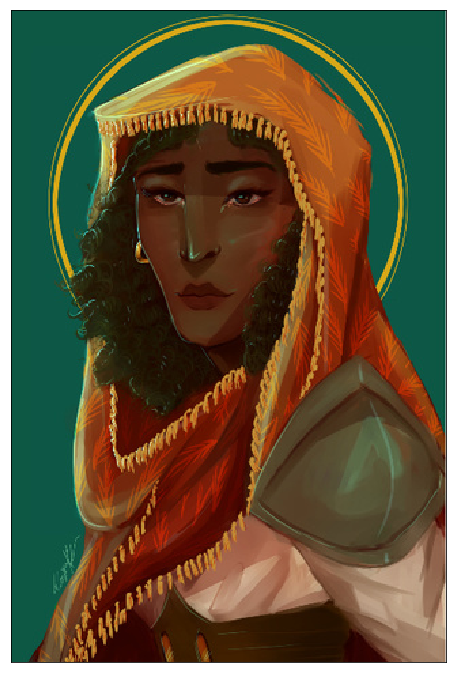

torch.Size([3, 224, 224])
images/gnome/00000065.jpg gnome

image:  images/gnome/00000065.jpg
tensor([[0.0005, 0.9349, 0.0646]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0262, 0.7321, 0.2417]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


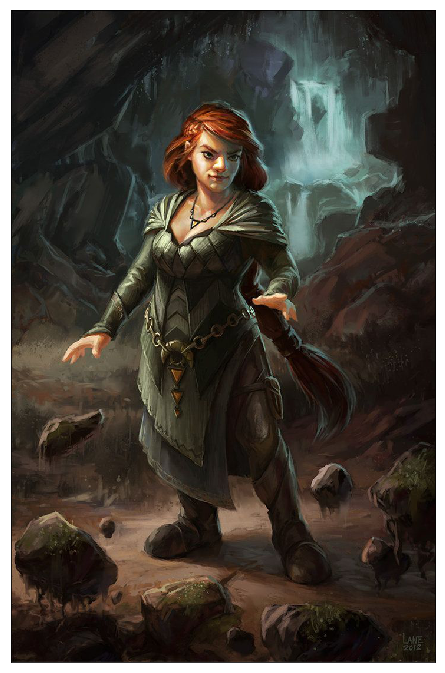

torch.Size([3, 224, 224])
images/gnome/00000014.jpg gnome

image:  images/gnome/00000014.jpg
tensor([[0.8897, 0.0206, 0.0897]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['dragonborn']
tensor([[0.8336, 0.1320, 0.0343]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


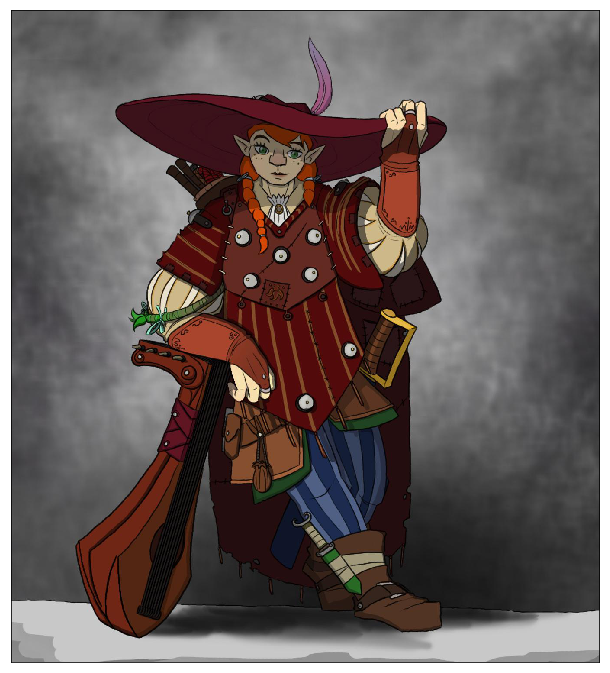

torch.Size([3, 224, 224])
images/gnome/00000226.jpg gnome

image:  images/gnome/00000226.jpg
tensor([[0.0008, 0.2213, 0.7779]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['gnome']
tensor([[0.0268, 0.9112, 0.0620]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


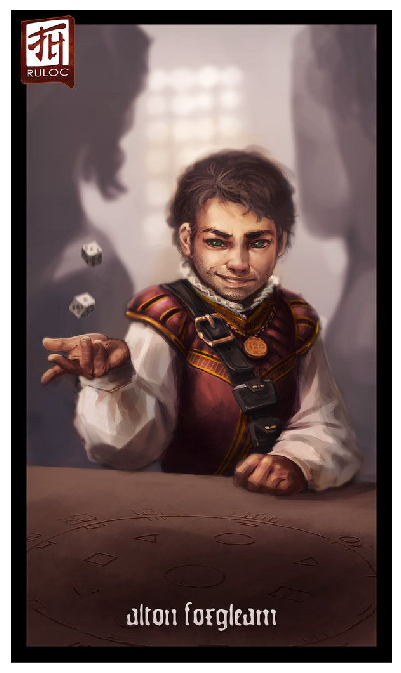

In [8]:

for index,row in race_sample.iterrows():
    plt.figure(figsize=(12,12))
    
    img_path = 'images/'+ row['folder']+'/'+row['image_number']
    image = image_loader(img_path)
    y_pred = model_1(image)
    print(img_path, row['folder'])
    print('')
    print('image: ', img_path )
    print(extract_label(race_label_list,y_pred[0]))
    print(extract_label(class_label_list,y_pred[1]))
    pil_im = Image.open(img_path)
    
    plt.imshow(np.asarray(pil_im))
    plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
    plt.show()

torch.Size([3, 224, 224])
images/paladin/00000113.jpg paladin

image:  images/paladin/00000113.jpg
tensor([[0.0972, 0.4910, 0.4118]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.4215, 0.2937, 0.2847]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


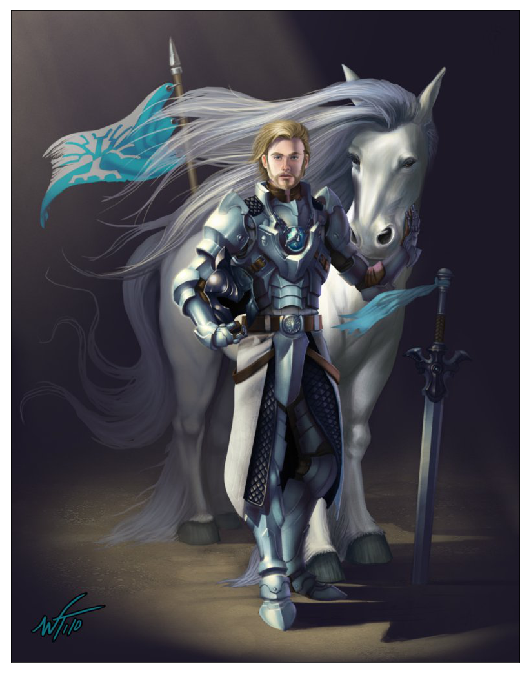

torch.Size([3, 224, 224])
images/paladin/00000040.jpg paladin

image:  images/paladin/00000040.jpg
tensor([[0.0096, 0.8562, 0.1342]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.1902, 0.5780, 0.2318]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


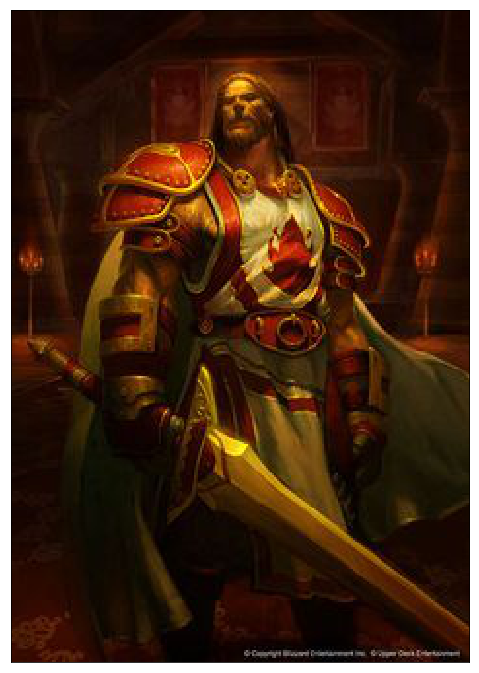

torch.Size([3, 224, 224])
images/rogue/00000001.jpg rogue

image:  images/rogue/00000001.jpg
tensor([[0.0038, 0.9694, 0.0269]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0375, 0.8759, 0.0866]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


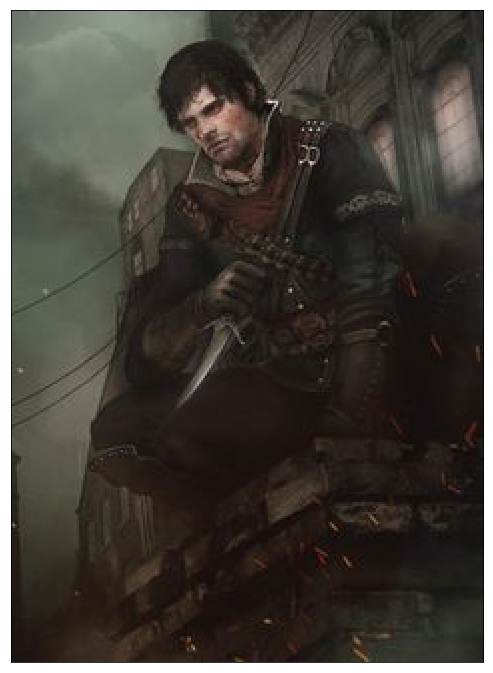

torch.Size([3, 224, 224])
images/rogue/00000269.jpg rogue

image:  images/rogue/00000269.jpg
tensor([[0.0144, 0.6286, 0.3570]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.1244, 0.8184, 0.0572]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


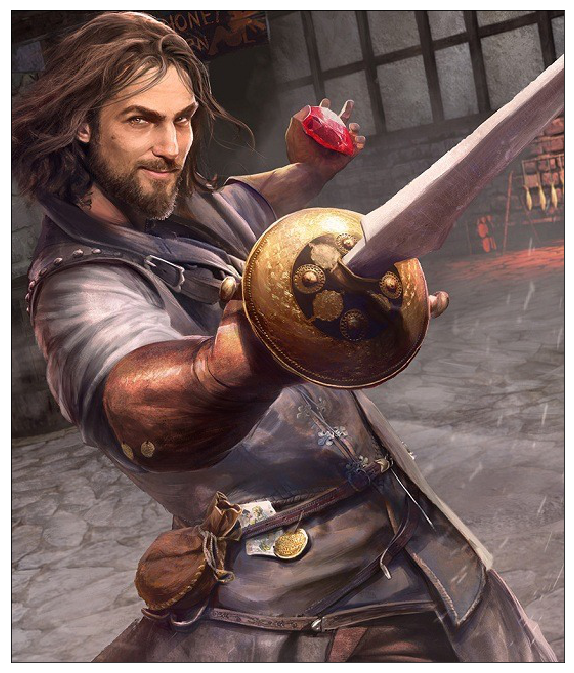

torch.Size([3, 224, 224])
images/rogue/00000061.jpg rogue

image:  images/rogue/00000061.jpg
tensor([[0.0102, 0.9339, 0.0559]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0648, 0.8826, 0.0526]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


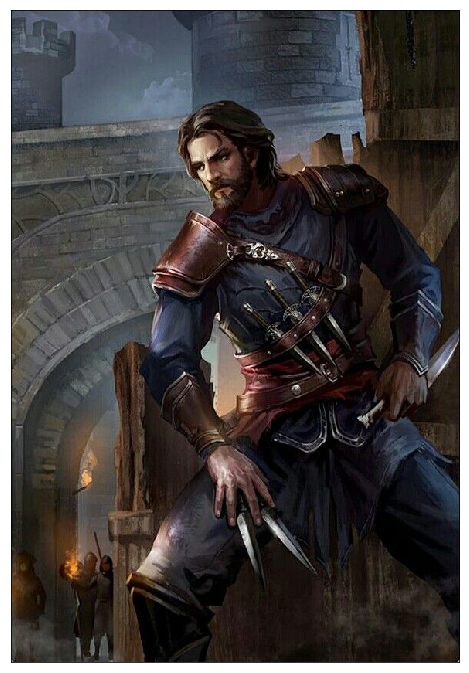

torch.Size([3, 224, 224])
images/paladin/00000136.jpg paladin

image:  images/paladin/00000136.jpg
tensor([[0.8526, 0.0784, 0.0690]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['dragonborn']
tensor([[0.5637, 0.0356, 0.4007]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


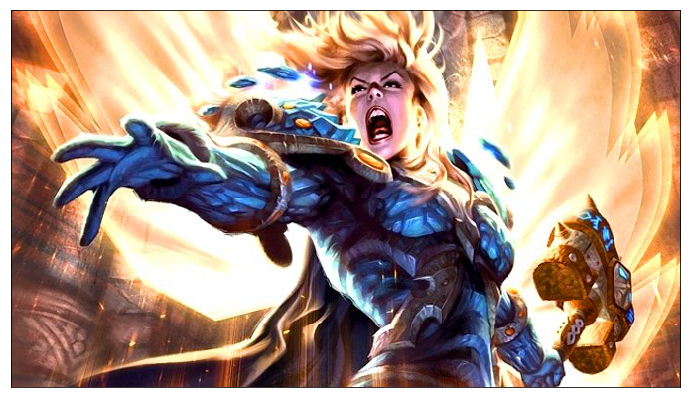

torch.Size([3, 224, 224])
images/rogue/00000054.jpg rogue

image:  images/rogue/00000054.jpg
tensor([[0.0524, 0.2236, 0.7241]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['gnome']
tensor([[0.1868, 0.7244, 0.0888]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


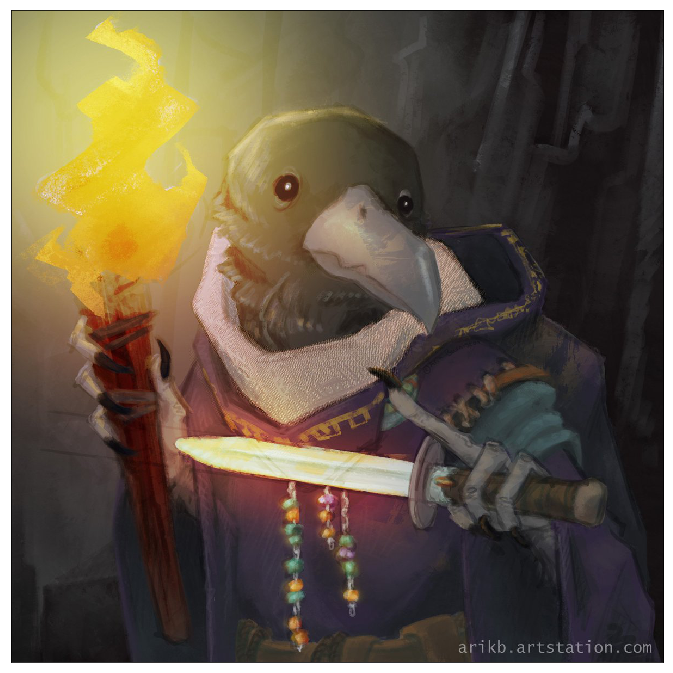

torch.Size([3, 224, 224])
images/rogue/00000007.jpg rogue

image:  images/rogue/00000007.jpg
tensor([[0.9885, 0.0054, 0.0061]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['dragonborn']
tensor([[0.8476, 0.1444, 0.0080]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


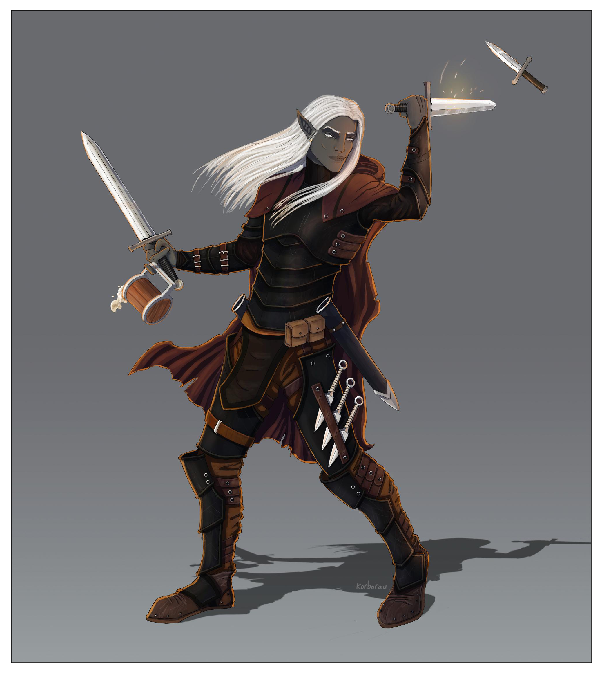

torch.Size([3, 224, 224])
images/rogue/00000021.jpg rogue

image:  images/rogue/00000021.jpg
tensor([[0.0003, 0.9993, 0.0004]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0293, 0.4213, 0.5494]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


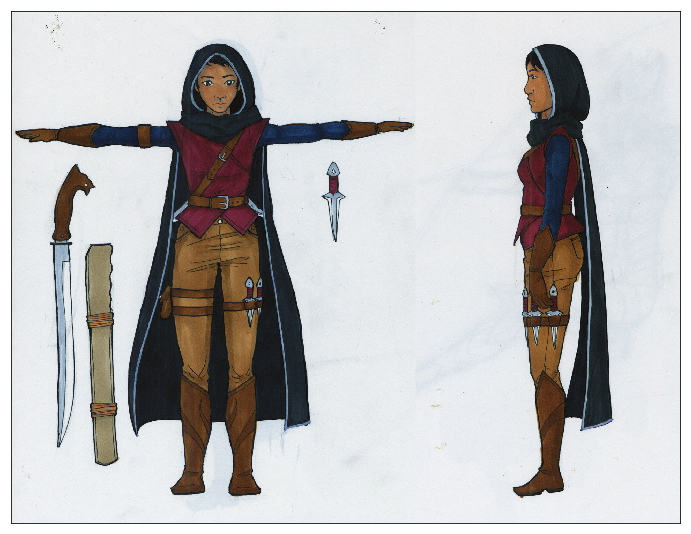

torch.Size([3, 224, 224])
images/rogue/00000145.jpg rogue

image:  images/rogue/00000145.jpg
tensor([[0.0220, 0.0022, 0.9758]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['gnome']
tensor([[0.5866, 0.3941, 0.0193]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


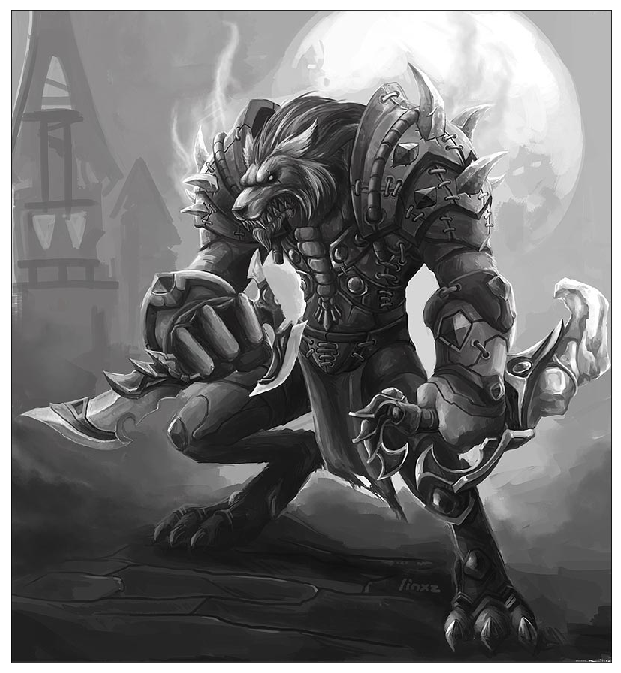

torch.Size([3, 224, 224])
images/wizard/00000100.jpg wizard

image:  images/wizard/00000100.jpg
tensor([[0.8798, 0.0911, 0.0291]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['dragonborn']
tensor([[0.7385, 0.0449, 0.2166]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


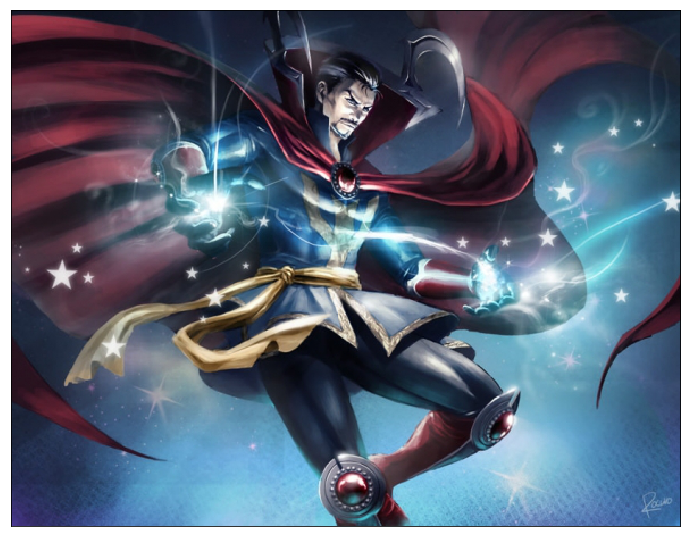

torch.Size([3, 224, 224])
images/rogue/00000091.jpg rogue

image:  images/rogue/00000091.jpg
tensor([[0.0054, 0.3858, 0.6088]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['gnome']
tensor([[0.0503, 0.8833, 0.0664]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


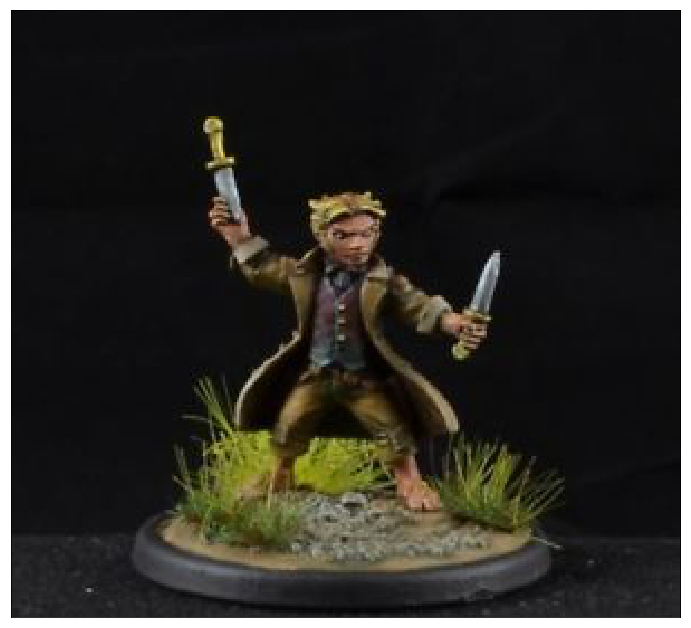

torch.Size([3, 224, 224])
images/rogue/00000161.jpg rogue

image:  images/rogue/00000161.jpg
tensor([[0.0058, 0.0104, 0.9838]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['gnome']
tensor([[0.1757, 0.8076, 0.0167]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


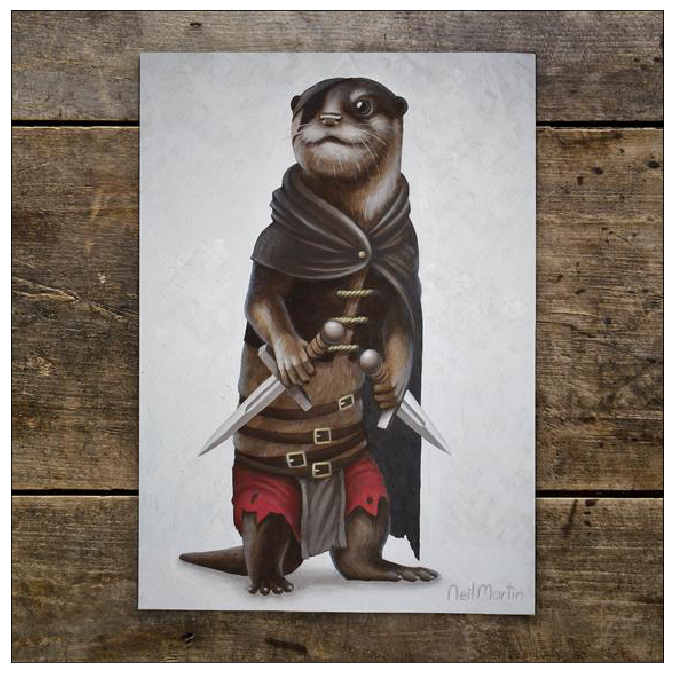

torch.Size([3, 224, 224])
images/wizard/00000066.jpg wizard

image:  images/wizard/00000066.jpg
tensor([[0.0021, 0.5735, 0.4244]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0908, 0.4461, 0.4631]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


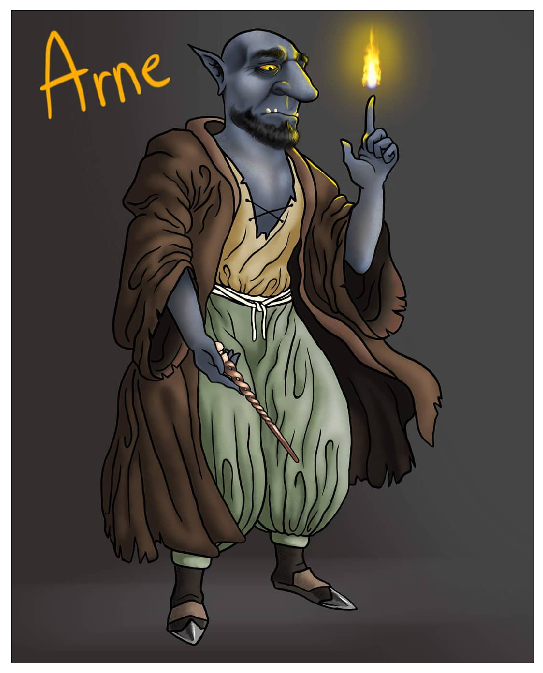

torch.Size([3, 224, 224])
images/rogue/00000228.jpg rogue

image:  images/rogue/00000228.jpg
tensor([[0.0001, 0.9994, 0.0005]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0042, 0.9599, 0.0359]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


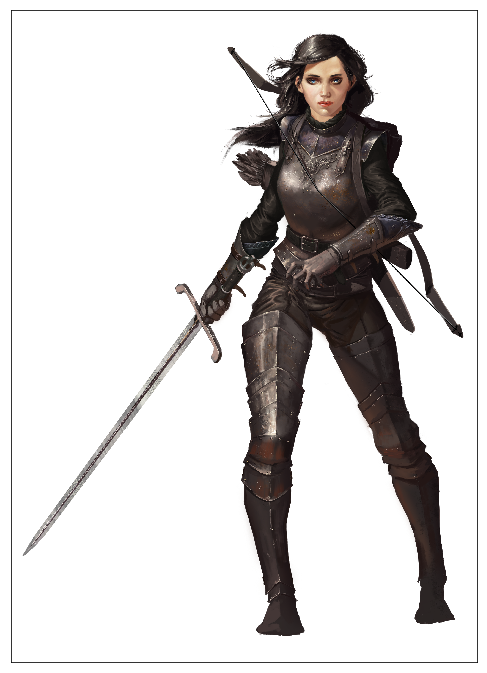

torch.Size([3, 224, 224])
images/rogue/00000102.jpg rogue

image:  images/rogue/00000102.jpg
tensor([[0.0018, 0.2287, 0.7695]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['gnome']
tensor([[0.0547, 0.8257, 0.1196]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


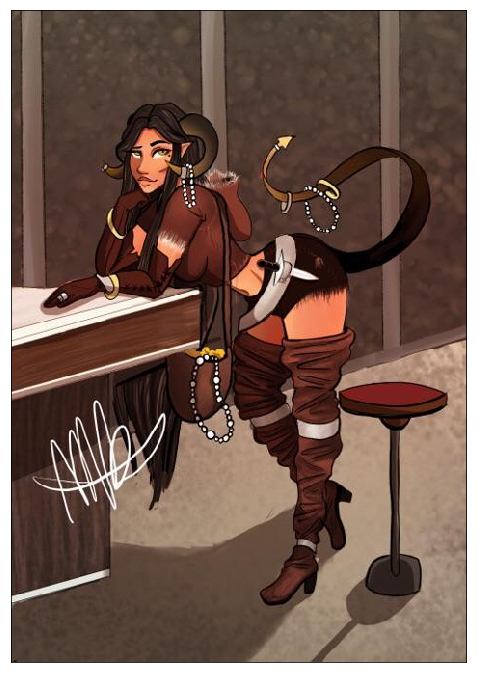

torch.Size([3, 224, 224])
images/wizard/00000284.jpg wizard

image:  images/wizard/00000284.jpg
tensor([[0.0215, 0.9742, 0.0043]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.1625, 0.1696, 0.6679]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


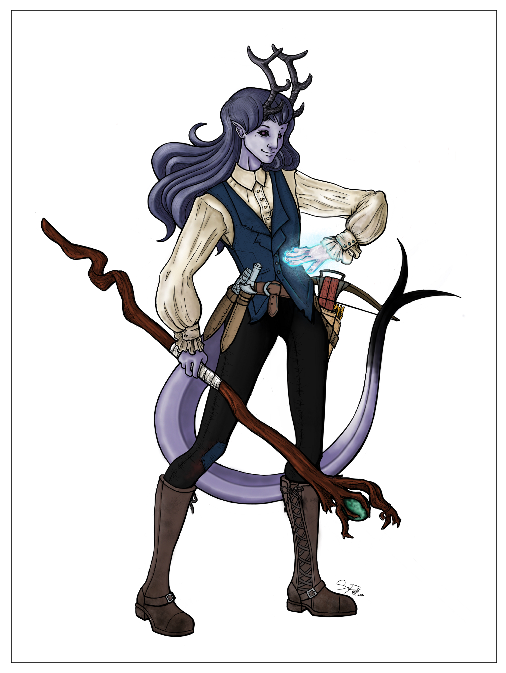

torch.Size([3, 224, 224])
images/paladin/00000131.jpg paladin

image:  images/paladin/00000131.jpg
tensor([[0.0461, 0.6793, 0.2746]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.1359, 0.8072, 0.0569]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


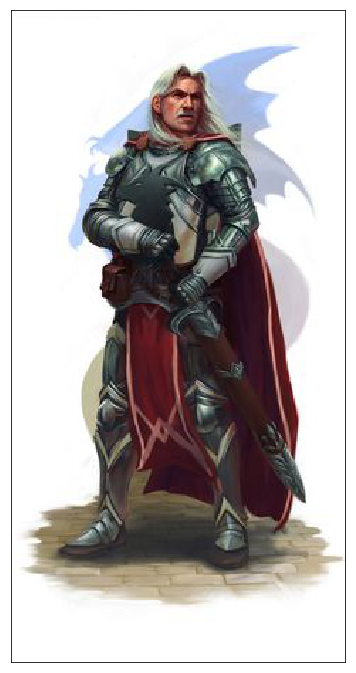

torch.Size([3, 224, 224])
images/rogue/00000297.jpg rogue

image:  images/rogue/00000297.jpg
tensor([[0.0011, 0.9939, 0.0050]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0351, 0.8110, 0.1538]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


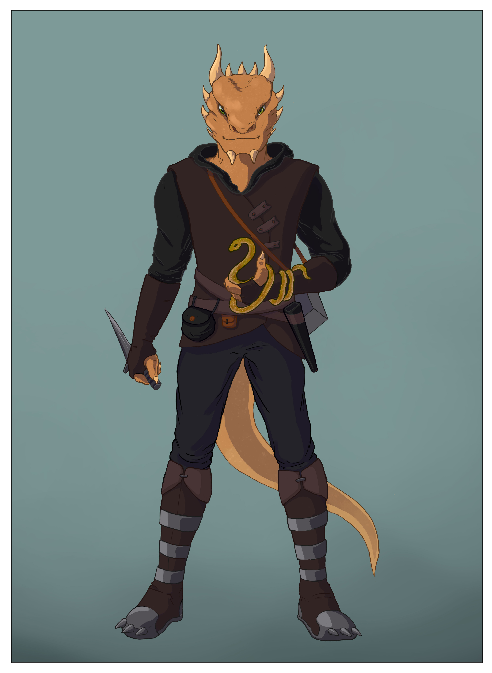

torch.Size([3, 224, 224])
images/rogue/00000071.jpg rogue

image:  images/rogue/00000071.jpg
tensor([[0.0303, 0.9668, 0.0029]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.2156, 0.1365, 0.6479]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


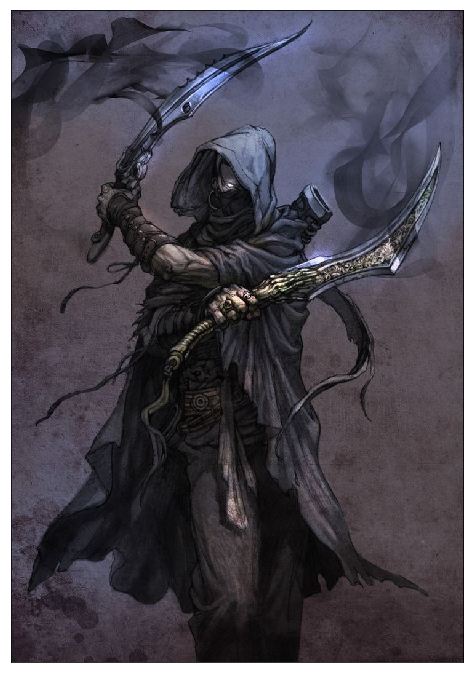

torch.Size([3, 224, 224])
images/rogue/00000217.jpg rogue

image:  images/rogue/00000217.jpg
tensor([[0.1627, 0.0200, 0.8173]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['gnome']
tensor([[0.6498, 0.3117, 0.0385]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


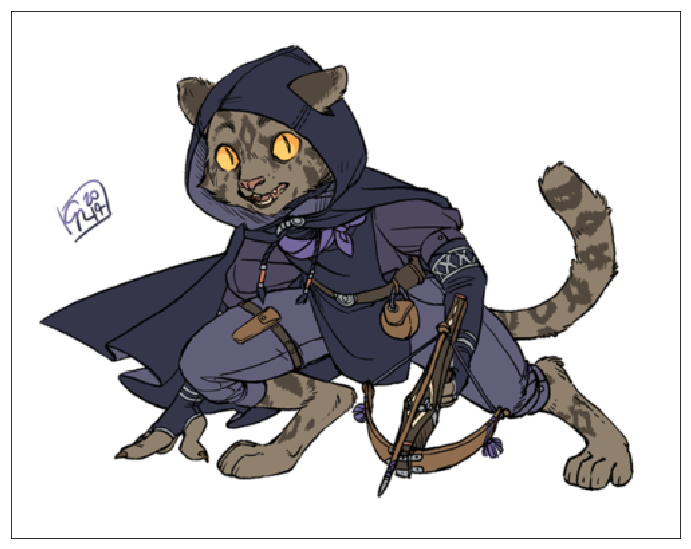

torch.Size([3, 224, 224])
images/paladin/00000027.jpg paladin

image:  images/paladin/00000027.jpg
tensor([[0.3728, 0.0137, 0.6135]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['gnome']
tensor([[0.7287, 0.2616, 0.0097]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


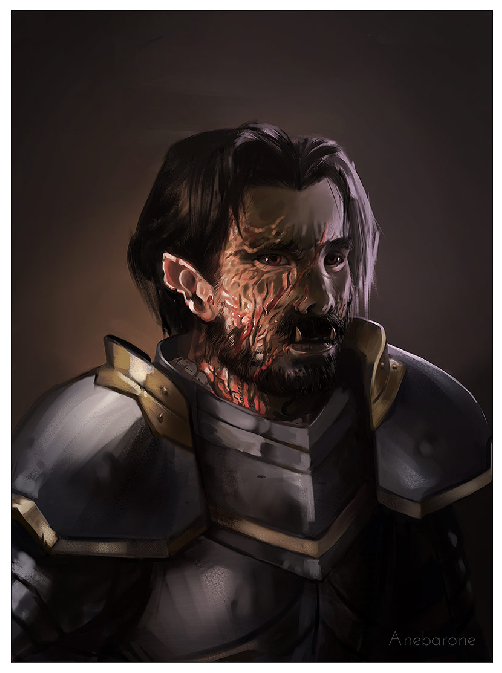

torch.Size([3, 224, 224])
images/paladin/00000108.jpg paladin

image:  images/paladin/00000108.jpg
tensor([[0.4684, 0.4384, 0.0932]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['dragonborn']
tensor([[0.6747, 0.2707, 0.0547]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


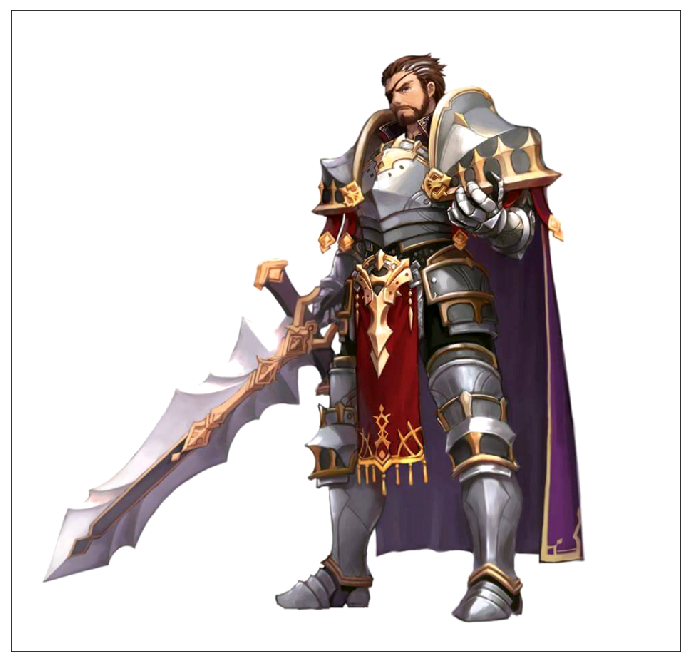

torch.Size([3, 224, 224])
images/rogue/00000052.jpg rogue

image:  images/rogue/00000052.jpg
tensor([[0.0014, 0.4891, 0.5095]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['gnome']
tensor([[0.0397, 0.8561, 0.1042]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


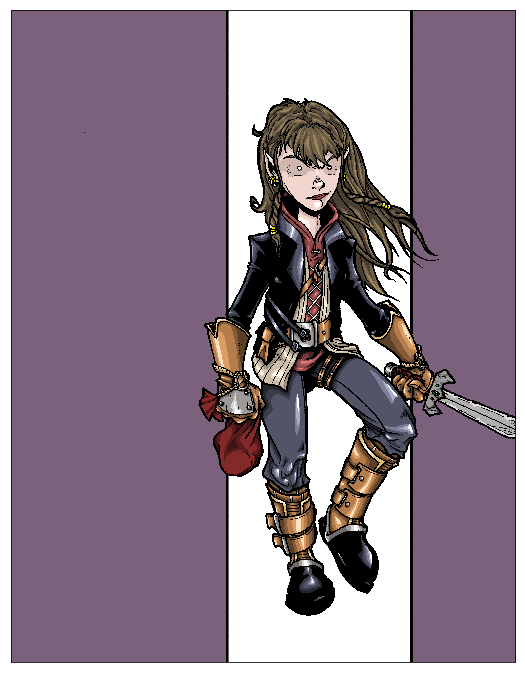

torch.Size([3, 224, 224])
images/wizard/00000063.jpg wizard

image:  images/wizard/00000063.jpg
tensor([[0.0029, 0.9862, 0.0109]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0662, 0.1126, 0.8212]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


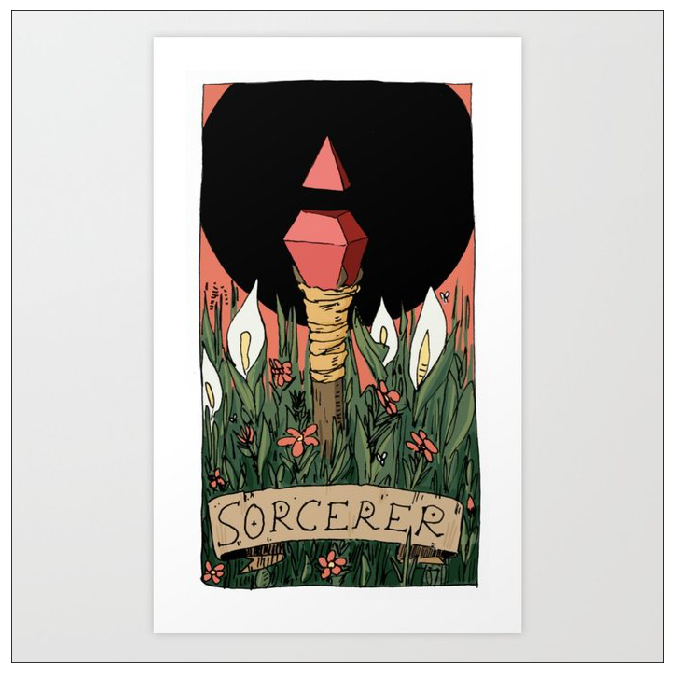

torch.Size([3, 224, 224])
images/wizard/00000196.jpg wizard

image:  images/wizard/00000196.jpg
tensor([[0.0014, 0.9753, 0.0233]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0482, 0.4137, 0.5381]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


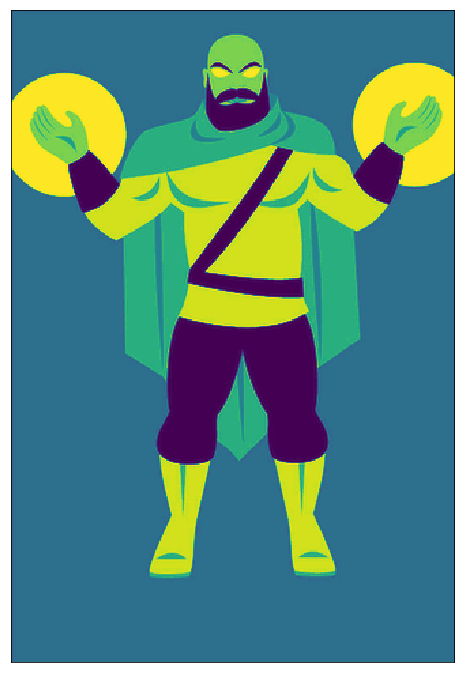

torch.Size([3, 224, 224])
images/rogue/00000018.jpg rogue

image:  images/rogue/00000018.jpg
tensor([[0.0010, 0.9927, 0.0063]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0494, 0.7062, 0.2444]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


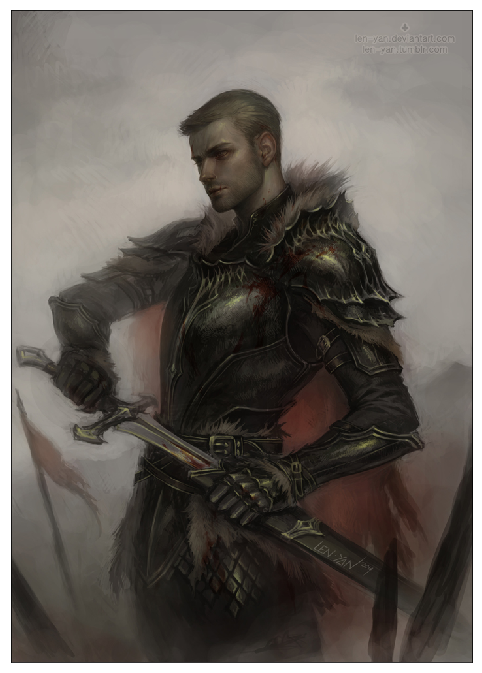

torch.Size([3, 224, 224])
images/wizard/00000019.jpg wizard

image:  images/wizard/00000019.jpg
tensor([[0.1707, 0.8171, 0.0121]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0987, 0.0123, 0.8890]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


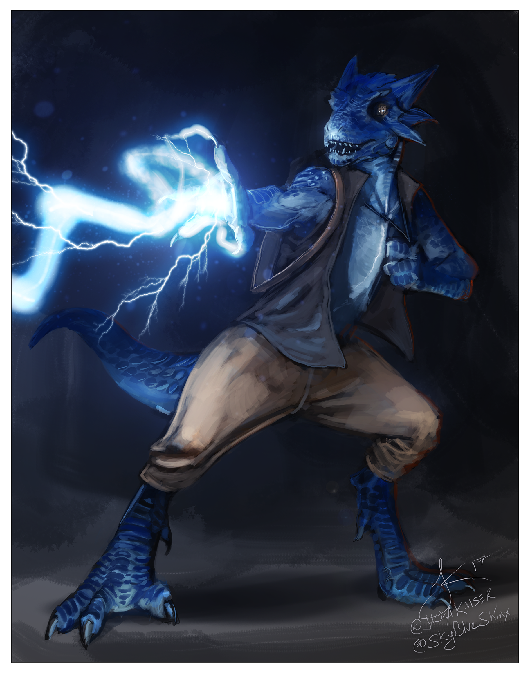

torch.Size([3, 224, 224])
images/wizard/00000012.jpg wizard

image:  images/wizard/00000012.jpg
tensor([[0.1094, 0.8781, 0.0125]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0587, 0.0075, 0.9338]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


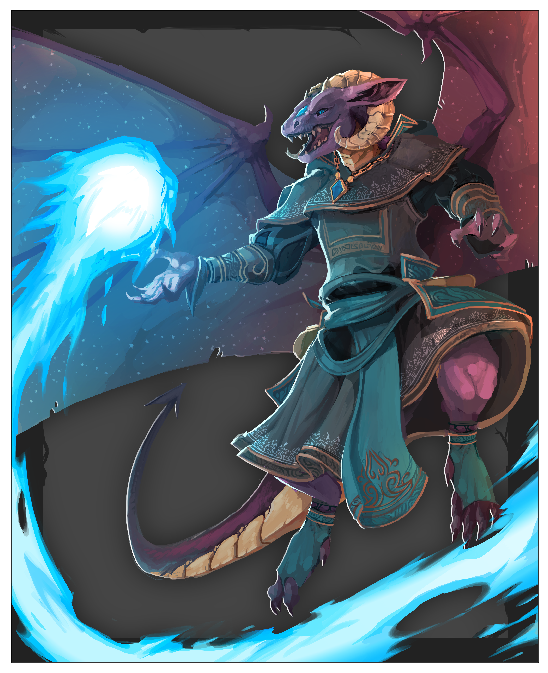

torch.Size([3, 224, 224])
images/paladin/00000225.jpg paladin

image:  images/paladin/00000225.jpg
tensor([[0.1305, 0.8624, 0.0071]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.4253, 0.4472, 0.1275]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


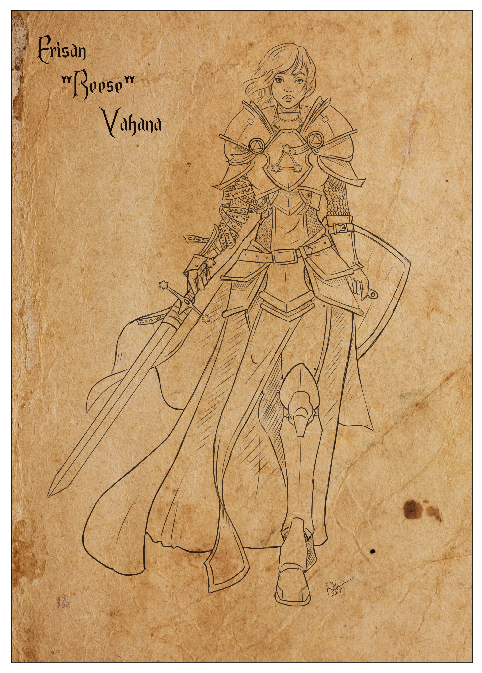

torch.Size([3, 224, 224])
images/rogue/00000301.jpg rogue

image:  images/rogue/00000301.jpg
tensor([[0.8092, 0.1506, 0.0402]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['dragonborn']
tensor([[0.5288, 0.4463, 0.0249]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


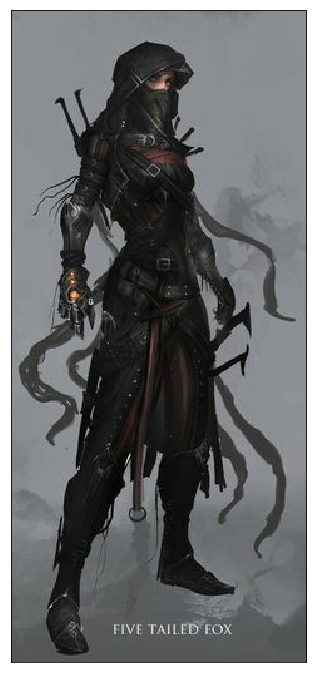

torch.Size([3, 224, 224])
images/rogue/00000063.jpg rogue

image:  images/rogue/00000063.jpg
tensor([[0.0047, 0.0493, 0.9460]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['gnome']
tensor([[0.1255, 0.8525, 0.0220]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


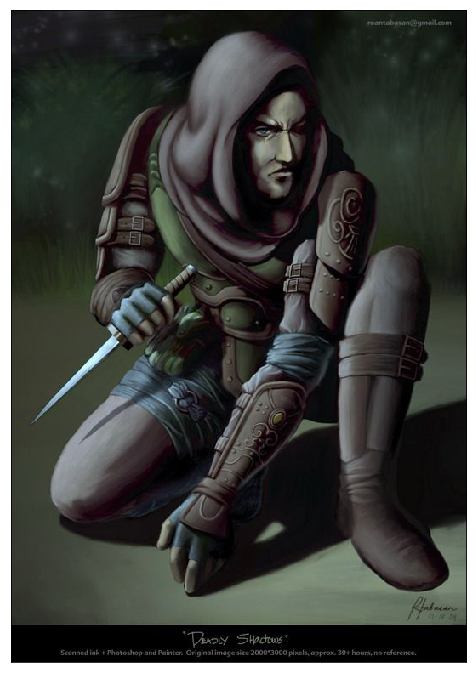

torch.Size([3, 224, 224])
images/wizard/00000023.jpg wizard

image:  images/wizard/00000023.jpg
tensor([[0.0126, 0.9716, 0.0158]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0402, 0.0135, 0.9463]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


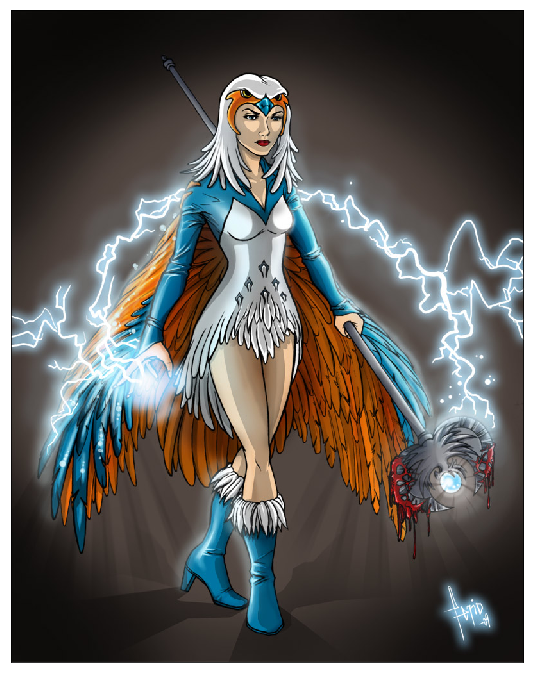

torch.Size([3, 224, 224])
images/paladin/00000175.jpg paladin

image:  images/paladin/00000175.jpg
tensor([[0.9552, 0.0054, 0.0394]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['dragonborn']
tensor([[0.9166, 0.0698, 0.0136]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


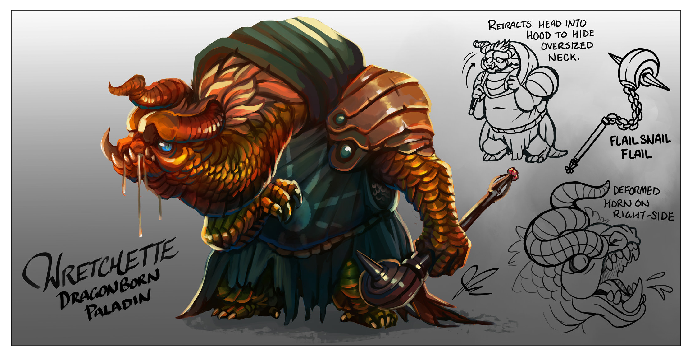

torch.Size([3, 224, 224])
images/wizard/00000010.jpg wizard

image:  images/wizard/00000010.jpg
tensor([[0.9270, 0.0109, 0.0621]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['dragonborn']
tensor([[0.8830, 0.0896, 0.0274]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


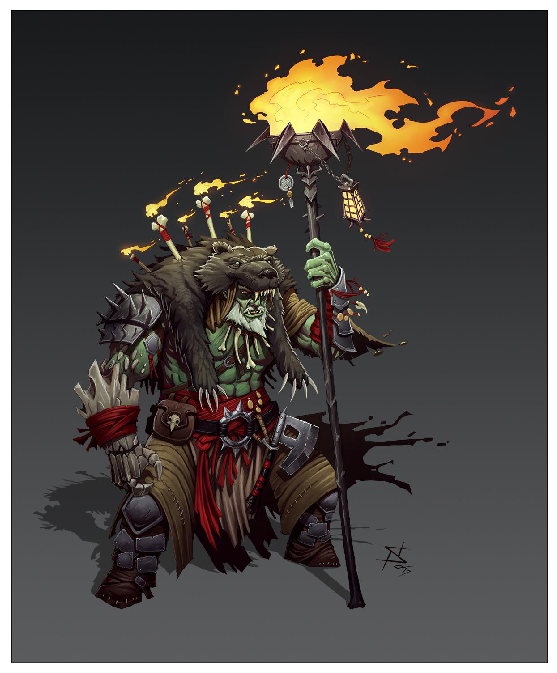

torch.Size([3, 224, 224])
images/paladin/00000004.jpg paladin

image:  images/paladin/00000004.jpg
tensor([[0.0129, 0.8965, 0.0907]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0690, 0.9084, 0.0225]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


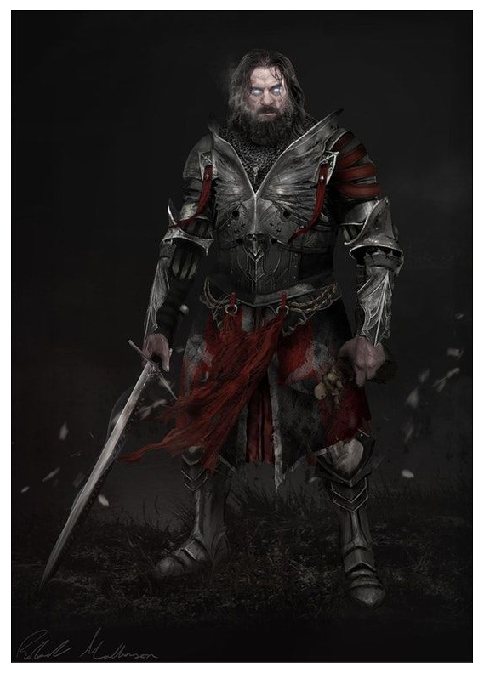

torch.Size([3, 224, 224])
images/wizard/00000217.jpg wizard

image:  images/wizard/00000217.jpg
tensor([[0.0008, 0.9831, 0.0161]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0504, 0.3108, 0.6388]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


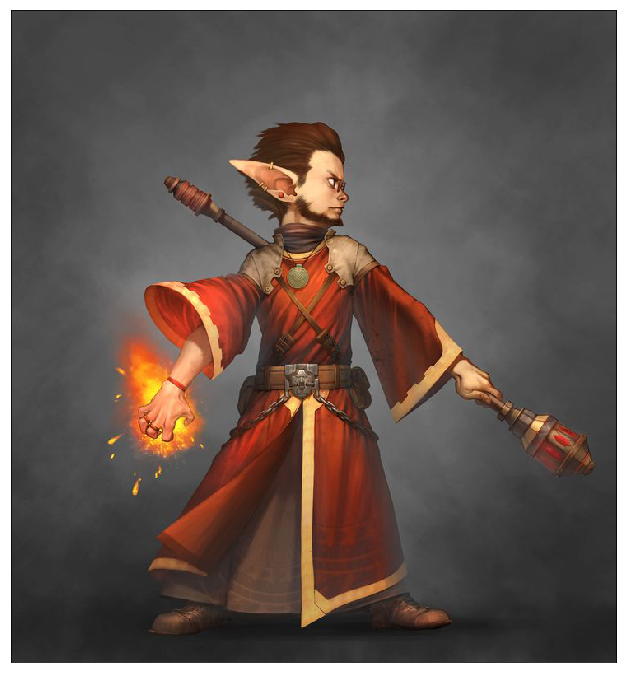

torch.Size([3, 224, 224])
images/paladin/00000196.jpg paladin

image:  images/paladin/00000196.jpg
tensor([[0.0067, 0.9655, 0.0278]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.1254, 0.4975, 0.3771]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


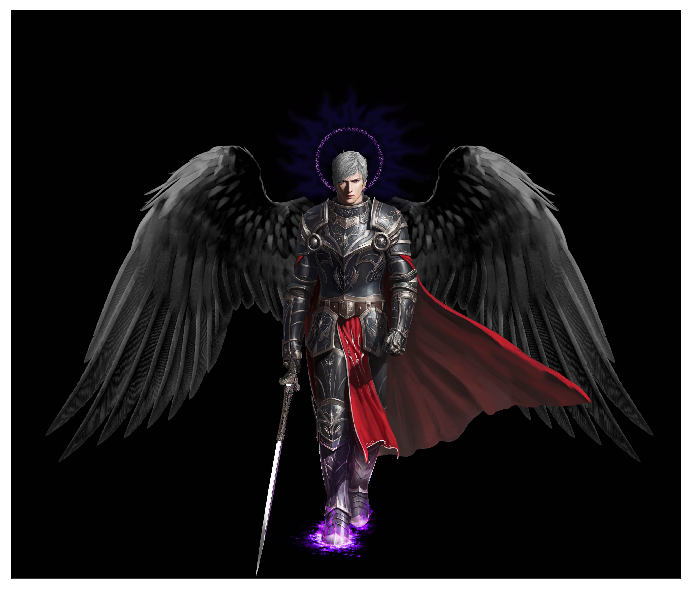

torch.Size([3, 224, 224])
images/paladin/00000079.jpg paladin

image:  images/paladin/00000079.jpg
tensor([[0.0019, 0.9897, 0.0084]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0886, 0.2502, 0.6612]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


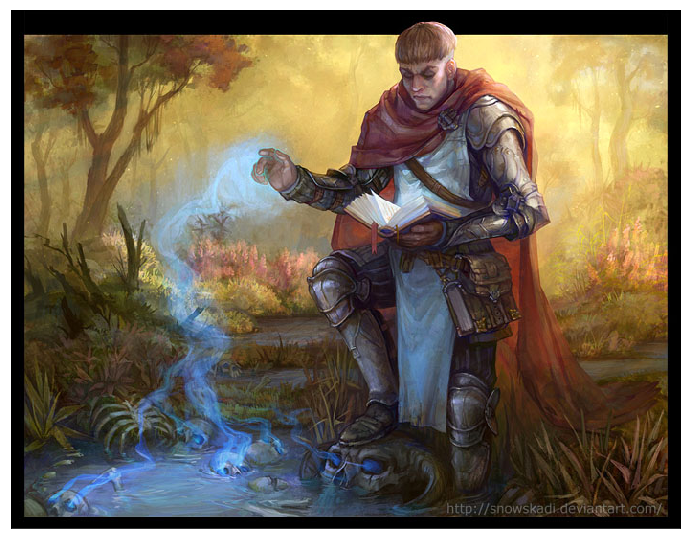

torch.Size([3, 224, 224])
images/paladin/00000007.jpg paladin

image:  images/paladin/00000007.jpg
tensor([[0.3659, 0.5714, 0.0627]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.5744, 0.2260, 0.1996]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['paladin/warrior']


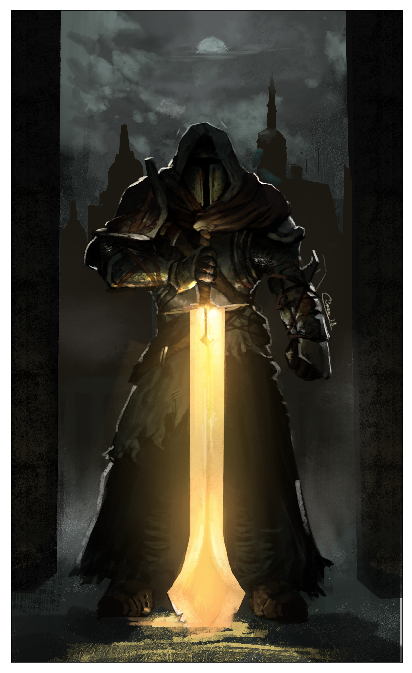

In [9]:

for index,row in class_sample.iterrows():
    plt.figure(figsize=(12,12))
    
    img_path = 'images/'+ row['folder']+'/'+row['image_number']
    image = image_loader(img_path)
    y_pred = model_1(image)
    print(img_path, row['folder'])
    print('')
    print('image: ', img_path )
    print(extract_label(race_label_list,y_pred[0]))
    print(extract_label(class_label_list,y_pred[1]))
    pil_im = Image.open(img_path)
    
    plt.imshow(np.asarray(pil_im))
    plt.xticks([]), plt.yticks([])  # to hide tick values on X and Y axis
    plt.show()

In [10]:
from PIL import Image
import requests
from io import BytesIO
url = 'https://media.dnd.wizards.com/styles/second_hubpage_banner/public/images/characters/EN_Classes_Rouge_Header.jpg'
response = requests.get(url)
img = Image.open(BytesIO(response.content))

torch.Size([3, 224, 224])
tensor([[0.0339, 0.9523, 0.0138]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.2186, 0.6561, 0.1253]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['rogue']


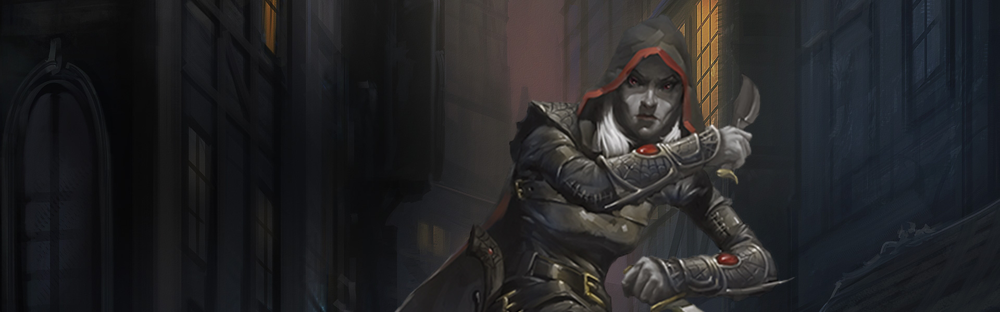

In [11]:

preds = model_1(image_loader(BytesIO(response.content)))

print(extract_label(race_label_list,preds[0]))
print(extract_label(class_label_list,preds[1]))

Image.open(BytesIO(response.content))

torch.Size([3, 224, 224])
tensor([[0.0016, 0.9955, 0.0029]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['human/elf']
tensor([[0.0165, 0.0193, 0.9642]], device='cuda:0', grad_fn=<SoftmaxBackward>)
['wizard']


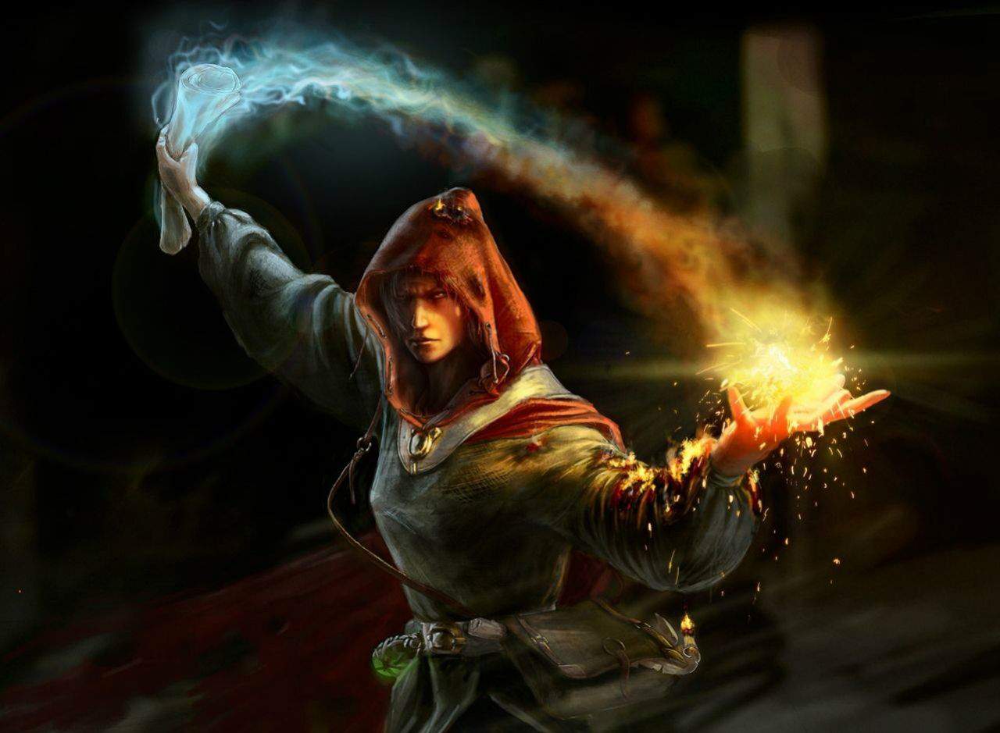

In [14]:

url = 'https://i.pinimg.com/originals/a1/9b/49/a19b49b21988f18a1f9703cfdc13d71b.jpg'
response = requests.get(url)

preds = model_1(image_loader(BytesIO(response.content)))

print(extract_label(race_label_list,preds[0]))
print(extract_label(class_label_list,preds[1]))

img = Image.open(BytesIO(response.content))
img